In [4]:
import sys
import subprocess

#import pkg_resources
#required = {'harmonypy','sklearn','scanpy','pandas', 'numpy', 'bbknn', 'scipy', 'matplotlib', 'seaborn' ,'scipy'}
#installed = {pkg.key for pkg in pkg_resources.working_set}
#missing = required - installed
#if missing:
#    print("Installing missing packages:" )
#    print(missing)
#    python = sys.executable
#    subprocess.check_call([python, '-m', 'pip', 'install', *missing], stdout=subprocess.DEVNULL)

%matplotlib inline
from collections import Counter
from collections import defaultdict
import scanpy as sc
import pandas as pd
import pickle as pkl
import numpy as np
from bbknn import bbknn
import scipy
import matplotlib.pyplot as plt
import re
import glob
import os
import sys
from geosketch import gs
from numpy import cov
import scipy.cluster.hierarchy as spc
import seaborn as sns; sns.set(color_codes=True)
from sklearn.linear_model import LogisticRegression
import sklearn
import harmonypy as hm
from pathlib import Path

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis',dpi_save=500, frameon=True, vector_friendly=True)
plt.rcParams['figure.figsize'] = [10, 10]

### Read main datasets

In [ ]:
# plot only cells of interest umap
# ver 4
#adata = sc.read('./combined_ys_fliv_mouse_141021.h5ad')
#Ver 5
#adata = sc.read('./full_combined_ys_fliv_mouse_scaled_seperately_251021.h5ad')
# ver 6
adata = sc.read('./full_combined_ys_fliv_mouse_scaled_seperately_261021.h5ad')
#ver7
#adata = sc.read('./full_combined_ys_fliv_mouse_scaled_seperately_281021.h5ad')

In [5]:
adata_hu_diff = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/adata_hu_diff.h5ad')
adata_ms_diff = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/adata_ms_diff.h5ad')
#adata_ms_dff_extended = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/extended_mouse_atlas/EmbryoData2020/embryo_mnn_bbknn_shiny.h5ad')

In [79]:
from rpy2.robjects import pandas2ri
#readRDS = robjects.r['readRDS']
#df = readRDS('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/extended_mouse_atlas/EmbryoData2020/integrated_meta_celltype_clus.rds')
#df = pandas2ri.rpy2py_dataframe(df)
df = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/extended_mouse_atlas/EmbryoData2020/integrated_meta_celltype_clus.csv')
df = df.set_index('cell')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3418: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [77]:
#df.to_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/extended_mouse_atlas/EmbryoData2020/integrated_meta_celltype_clus.csv')

# Update mouse annotation

In [53]:
meta = adata_ms_diff.obs.copy()
meta[list(df.columns)] = df[df.index.isin(meta.index)]
adata_ms_diff.obs = meta

### Freq distribution for mouse predictions

In [54]:
adata_ms_diff

AnnData object with n_obs × n_vars = 4717 × 1452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'celltype', 'species', 'species_donor', 'n_counts', 'restricted_celltype', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'cell_cycle_score', 'cat_index', 'batch', 'leiden', 'predicted_human_mouse', 'num', 'leiden_num', 'prediction', 'predicted', 'predicted_num', 'stage.mapped', 'stage.collapsed', 'stage.mapped.collapsed', 'somite_count', 'tube_name', 'tube_name_corrected', 'celltype.extended', 'celltype.descendant', 'celltype.descendant.somites', 'doub.density', 'cluster', 'cluster.sub', 'celltype.clustering'
    var: 'HGNC-0', 'ENSDB-0', 'mouse_human_homologs-0', 'DB Class Key_homogene_db-0', 'Common Organism Name_homogene_db-0', 'NCBI Taxon ID_homogene_db-0', 'Symbol_homogene_db-0', 'EntrezGene ID_homogene_db-0', 'Mouse MGI ID_homogene_db-0', 'HGNC ID_homogene_db

In [55]:
pred_out = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/lr_outs/pred_out.csv',index_col = 0)
adata_ms_diff.obs['predicted'] = pred_out.loc[pred_out.index.isin(adata_ms_diff.obs.index),'predicted']

In [56]:
cluster_prediction = "clus_prediction"
clusters_reassign = "leiden"
lr_predicted_col = 'predicted'

In [57]:
lm = 1 # lambda value
adata_ms_diff.obs[cluster_prediction] = adata_ms_diff.obs[clusters_reassign]
for z in adata_ms_diff.obs[clusters_reassign].unique():
    df = adata_ms_diff.obs
    df = df[(df[clusters_reassign].isin([z]))]
    df_count = pd.DataFrame(df[lr_predicted_col].value_counts())
    print(z)
# Look for classificationds > 68CI
    if len(df_count) > 1:
        df_count_temp = df_count[df_count[lr_predicted_col]>int(int(df_count.mean()) + (df_count.std()*lm))]
        if len(df_count_temp >= 1):
            df_count = df_count_temp
    print(df_count)     
    freq_arranged = df_count.index
    cat = freq_arranged[0]
    #df.loc[:,cluster_prediction] = cat
#Make the cluster assignment first
    cat = cat.replace('_ys','') + '_lineage_mouse_gastrulation'
    adata_ms_diff.obs[cluster_prediction] = adata_ms_diff.obs[cluster_prediction].astype(str)
    adata_ms_diff.obs.loc[adata_ms_diff.obs[clusters_reassign] == z, [cluster_prediction]] = cat
    print(cat)
# Create assignments for any classification >68CI
    for cats in freq_arranged:
        print(cats)
        cats_assignment = cats.replace('_ys','') + '_lineage_mouse_gastrulation'
        adata_ms_diff.obs.loc[(adata_ms_diff.obs[clusters_reassign] == z) & (adata_ms_diff.obs[lr_predicted_col] == cats),[cluster_prediction]] = cats_assignment 
# reassign prediction columns
adata_ms_diff.obs[lr_predicted_col] = adata_ms_diff.obs[cluster_prediction][:]
del adata_ms_diff.obs[cluster_prediction]
adata_ms_diff.obs

# remove subclusters
#adata_ms_diff.obs['predicted']  = adata_ms_diff.obs['predicted'].str.replace('_\d+_','_').astype(str)
#adata_ms_diff.obs['predicted']  = adata_ms_diff.obs['predicted'].str.replace('_ys','').astype(str)
adata_ms_diff.obs

9
           predicted
HSPC_1_ys        120
HSPC_1_lineage_mouse_gastrulation
HSPC_1_ys
4
               predicted
Macrophage_ys        290
Macrophage_lineage_mouse_gastrulation
Macrophage_ys
0
           predicted
HSPC_1_ys        729
HSPC_1_lineage_mouse_gastrulation
HSPC_1_ys
6
       predicted
MK_ys        330
MK_lineage_mouse_gastrulation
MK_ys
7
       predicted
MK_ys        113
MK_lineage_mouse_gastrulation
MK_ys
8
              predicted
Erythroid_ys        160
Erythroid_lineage_mouse_gastrulation
Erythroid_ys
2
              predicted
Erythroid_ys        642
Erythroid_lineage_mouse_gastrulation
Erythroid_ys
5
              predicted
Erythroid_ys        409
Erythroid_lineage_mouse_gastrulation
Erythroid_ys
11
        predicted
CMP_ys          6
CMP_lineage_mouse_gastrulation
CMP_ys
3
              predicted
Erythroid_ys        578
Erythroid_lineage_mouse_gastrulation
Erythroid_ys
1
              predicted
Erythroid_ys        705
Erythroid_lineage_mouse_gastrulation
Erythroid_ys

,barcode,sample,stage,sequencing.batch,celltype,species,species_donor,n_counts,restricted_celltype,n_genes,...,somite_count,tube_name,tube_name_corrected,celltype.extended,celltype.descendant,celltype.descendant.somites,doub.density,cluster,cluster.sub,celltype.clustering
cell_363,AAAGATCTCTCGAA,2,E7.5,1,Blood progenitors 2,Mouse,Mouse_2,11274.0,Blood progenitors 2_2,2731,...,Undetermined,Undetermined,Undetermined,Blood progenitors 2,Blood progenitors 2,Blood progenitors 2,0.567849,2.0,3.0,Blood progenitors
cell_382,AATCTCACTGCTTT,2,E7.5,1,Blood progenitors 2,Mouse,Mouse_2,8414.0,Blood progenitors 2_2,2608,...,Undetermined,Undetermined,Undetermined,Blood progenitors 2,Blood progenitors 2,Blood progenitors 2,0.528195,4.0,1.0,Blood progenitors
cell_385,AATGGCTGAAGATG,2,E7.5,1,Blood progenitors 2,Mouse,Mouse_2,14521.0,Blood progenitors 2_2,3110,...,Undetermined,Undetermined,Undetermined,Blood progenitors 2,Blood progenitors 2,Blood progenitors 2,0.774525,4.0,1.0,Blood progenitors
cell_393,ACACATCTGTCAAC,2,E7.5,1,Blood progenitors 2,Mouse,Mouse_2,10735.0,Blood progenitors 2_3,2477,...,Undetermined,Undetermined,Undetermined,Blood progenitors 2,Blood progenitors 2,Blood progenitors 2,0.288178,2.0,3.0,Blood progenitors
cell_410,ACTCCCGAGTCACA,2,E7.5,1,Blood progenitors 1,Mouse,Mouse_2,15950.0,Blood progenitors 1_0,3474,...,Undetermined,Undetermined,Undetermined,Blood progenitors 1,Blood progenitors 1,Blood progenitors 1,1.125238,4.0,2.0,Haematoendothelial progenitors
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
cell_139315,TTTATCCTGTCACA,37,E8.5,3,Erythroid1,Mouse,Mouse_37,11011.0,Erythroid1_3,2669,...,Undetermined,Undetermined,Undetermined,Erythroid1,Erythroid1,Erythroid1,0.018075,2.0,7.0,MEP
cell_139321,TTTCAGTGCGAGTT,37,E8.5,3,Erythroid3,Mouse,Mouse_37,13763.0,Erythroid3_1,2956,...,Undetermined,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.432412,2.0,5.0,Erythroid
cell_139326,TTTCGAACGGTGAG,37,E8.5,3,Erythroid3,Mouse,Mouse_37,18515.0,Erythroid3_0,3258,...,Undetermined,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.476074,2.0,5.0,Erythroid
cell_139327,TTTCGAACTAACCG,37,E8.5,3,Erythroid3,Mouse,Mouse_37,11905.0,Erythroid3_1,2725,...,Undetermined,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.303505,2.0,10.0,Erythroid


In [58]:
adata_ms_diff.obs['predicted'].value_counts()

Erythroid_lineage_mouse_gastrulation     2599
HSPC_1_lineage_mouse_gastrulation         928
MK_lineage_mouse_gastrulation             649
Macrophage_lineage_mouse_gastrulation     525
CMP_lineage_mouse_gastrulation             16
Name: predicted, dtype: int64

In [59]:
adata_ms_diff.obs['predicted'] = adata_ms_diff.obs['predicted'].str.replace('CMP_lineage_mouse_gastrulation','MK_lineage_mouse_gastrulation')

In [60]:
#adata_ms_diff.obs['predicted'] = adata_ms_diff.obs['predicted'].astype(str)
#adata_ms_diff.obs['predicted'][adata_ms_diff.obs['leiden']=='7'] = 'MEMP_lineage_mouse_gastrulation'

In [61]:
col_selector = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/human_mouse_pal_relabel.csv')
col_selector = dict(zip(col_selector.iloc[:,0],col_selector.iloc[:,1]))

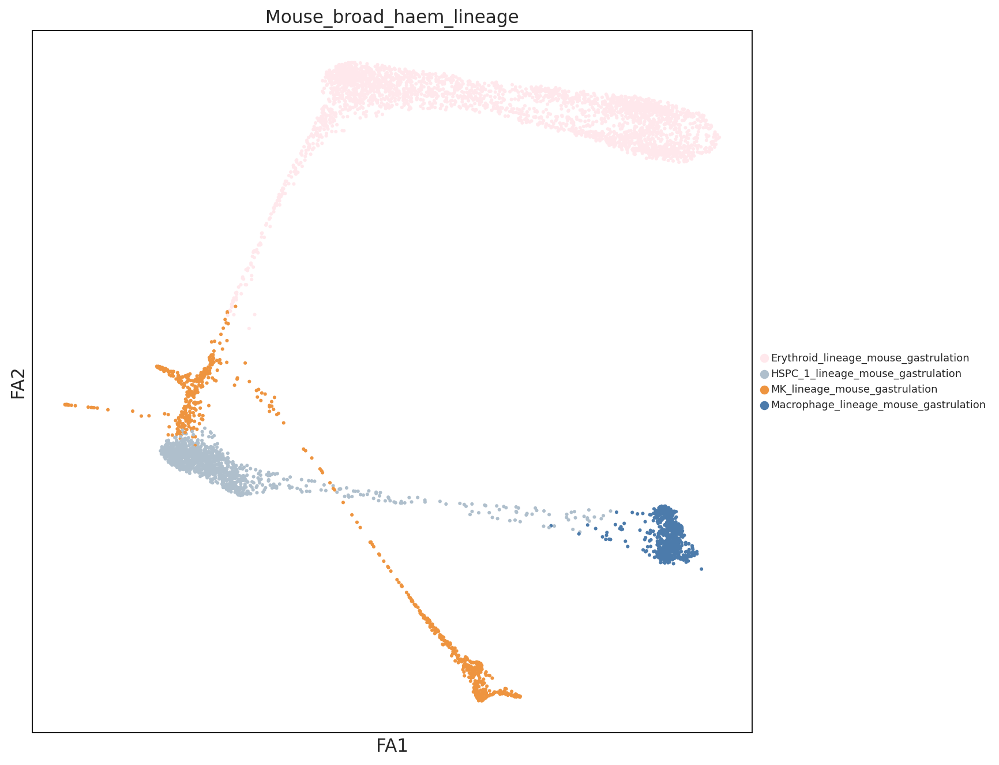

In [66]:
sc.pl.draw_graph(adata_ms_diff, color = 'predicted',size=30,legend_fontsize='xx-small',title="Mouse_broad_haem_lineage", palette= col_selector,save = "FDG_Mouse_broad_haem_lineage") 

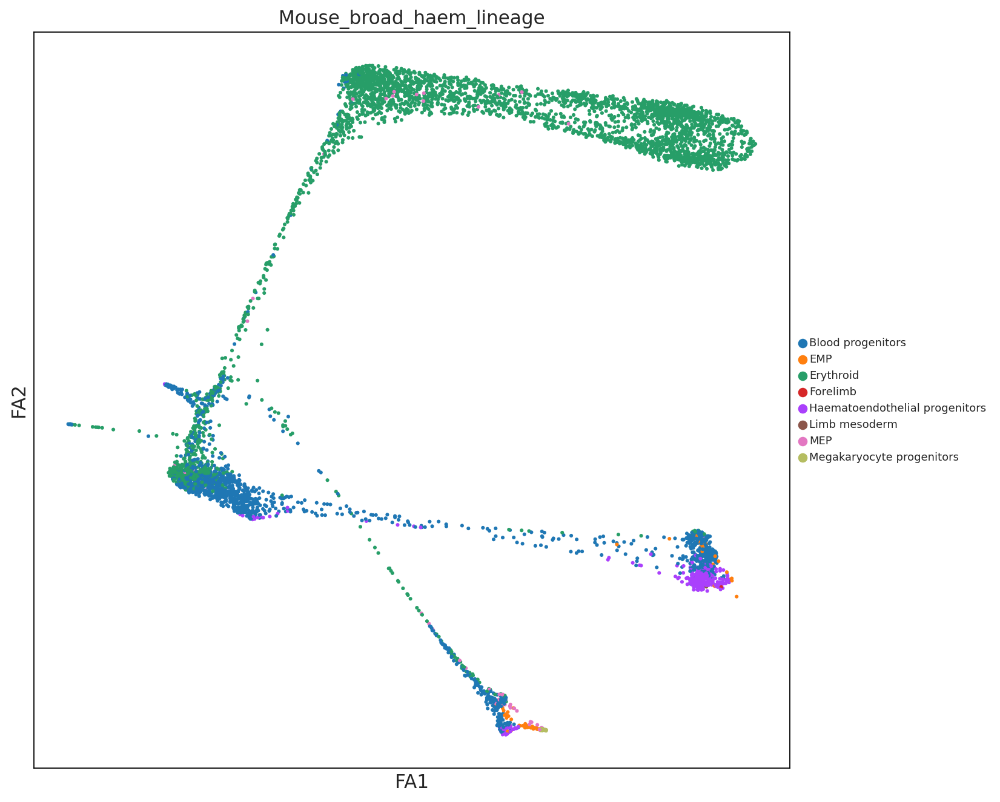

In [67]:
sc.pl.draw_graph(adata_ms_diff, color = 'celltype.clustering',size=30,legend_fontsize='xx-small',title="Mouse_broad_haem_lineage") 

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predicted' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will

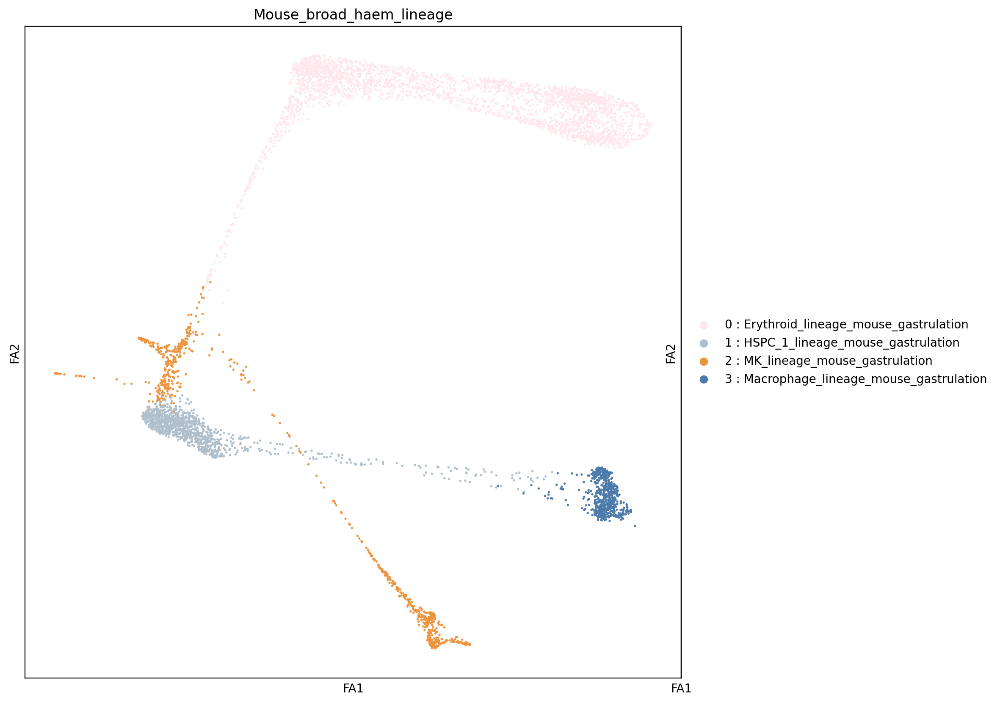

In [400]:
var = 'corr_concat'
var = 'predicted'
#var =  'predicted_human_mouse'
#Create color dictionary
cells = mu_keep  #list(adata.obs[var].unique())
cells = sorted(list(adata_ms_diff.obs[var].astype(str).unique()))
cells = [str(s) for s in cells]
col = list(range(0,len(adata_ms_diff.obs[var].unique())))
dic = dict(zip(cells,col))

#Create a mappable field
adata_ms_diff.obs['num'] = adata_ms_diff.obs[var]
#map to adata.obs.col to create a caterorical column
adata_ms_diff.obs['num'] = adata_ms_diff.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata_ms_diff.obs['num'] =adata_ms_diff.obs['num'].astype(str)
adata_ms_diff.obs[var+'_num'] = adata_ms_diff.obs['num'].astype(str) + " : " + adata_ms_diff.obs[var].astype(str)

col_pal = ['#FFE8EC','#afbfcc','#ee943f','#4c7bab']

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.draw_graph(adata_ms_diff, color = (var+'_num') ,ax=ax2,show=False,title="", palette= col_pal) #title=i
p3 = sc.pl.draw_graph(adata_ms_diff, color = "num",legend_loc=None,size=15,legend_fontsize='xx-small',ax=ax1,show=False,title="Mouse_broad_haem_lineage", palette= col_pal) #title=i
fig.savefig('./'+var+"_mouse_num.pdf",bbox_inches='tight')

In [405]:
adata_ms_dff.write('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/adata_ms_diff.h5ad') 

# Plot the LR probibility plots

In [68]:
pred_out = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/lr_outs/pred_out.csv',index_col = 0)

# add newer labels to pred_out

In [74]:
df

,barcode,sample,stage,sequencing.batch,celltype,species,species_donor,n_counts,restricted_celltype,n_genes,...,tube_name,tube_name_corrected,celltype.extended,celltype.descendant,celltype.descendant.somites,doub.density,cluster,cluster.sub,celltype.clustering,clus_prediction
cell_32542,CAAAGCACACACTG,16,E8.0,2,Erythroid2,Mouse,Mouse_16,6758.0,Erythroid2_2,1999,...,Undetermined,Undetermined,Erythroid2,Erythroid2,Erythroid2,0.183719,2.0,2.0,Erythroid,1
cell_34840,GGAGGTGAATGTCG,16,E8.0,2,Erythroid1,Mouse,Mouse_16,7872.0,Erythroid1_3,2146,...,Undetermined,Undetermined,Erythroid1,Erythroid1,Erythroid1,0.174201,2.0,2.0,Erythroid,1
cell_36253,TGACTTTGATCGTG,16,E8.0,2,Erythroid2,Mouse,Mouse_16,9985.0,Erythroid2_1,2453,...,Undetermined,Undetermined,Erythroid2,Erythroid2,Erythroid2,0.129226,2.0,2.0,Erythroid,1
cell_36867,AAACATTGGACGAG,17,E8.5,2,Erythroid3,Mouse,Mouse_17,8270.0,Erythroid3_2,2096,...,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.070837,2.0,5.0,Erythroid,1
cell_36885,AAAGACGATACTGG,17,E8.5,2,Erythroid3,Mouse,Mouse_17,12680.0,Erythroid3_3,2733,...,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.168011,2.0,10.0,Erythroid,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
cell_139244,TTCGTATGCCGCTT,37,E8.5,3,Erythroid3,Mouse,Mouse_37,13497.0,Erythroid3_1,2789,...,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.335440,2.0,5.0,Erythroid,1
cell_139249,TTCTAGTGCAAGCT,37,E8.5,3,Erythroid3,Mouse,Mouse_37,16631.0,Erythroid3_1,3231,...,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.523728,2.0,5.0,Erythroid,1
cell_139321,TTTCAGTGCGAGTT,37,E8.5,3,Erythroid3,Mouse,Mouse_37,13763.0,Erythroid3_1,2956,...,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.432412,2.0,5.0,Erythroid,1
cell_139326,TTTCGAACGGTGAG,37,E8.5,3,Erythroid3,Mouse,Mouse_37,18515.0,Erythroid3_0,3258,...,Undetermined,Undetermined,Erythroid3,Erythroid3,Erythroid3,0.476074,2.0,5.0,Erythroid,1


In [96]:
df['tube_name_corrected']

cell
cell_1             Undetermined
cell_2             Undetermined
cell_5             Undetermined
cell_6             Undetermined
cell_8             Undetermined
                       ...     
ext_cell_351868              YS
ext_cell_351869              YS
ext_cell_351870              YS
ext_cell_351871              YS
ext_cell_351872              YS
Name: tube_name_corrected, Length: 430339, dtype: object

In [89]:
df['celltype.extended'].value_counts()

Undetermined                      272864
Epiblast                           14619
ExE ectoderm                       11758
Forebrain/Midbrain/Hindbrain       10633
ExE endoderm                       10596
Primitive Streak                    7265
Erythroid3                          7175
Mesenchyme                          6919
Paraxial mesoderm                   6875
Surface ectoderm                    6612
Rostral neurectoderm                5392
Pharyngeal mesoderm                 5260
Nascent mesoderm                    5028
NMP                                 4845
Intermediate mesoderm               4710
ExE mesoderm                        4629
Haematoendothelial progenitors      4050
Spinal cord                         3968
Allantois                           3892
Somitic mesoderm                    3654
Erythroid1                          3276
Gut                                 3106
Blood progenitors 2                 2746
Caudal epiblast                     2445
Erythroid2      

In [90]:
pred_out['orig_labels'] = df['celltype.extended']

In [92]:
pred_out['orig_labels'].value_counts()

ExE endoderm                      4670
Erythroid1                        1402
Haematoendothelial progenitors    1365
Erythroid3                        1304
ExE mesoderm                      1286
Blood progenitors 2               1247
Visceral endoderm                  640
Erythroid2                         495
Blood progenitors 1                301
Name: orig_labels, dtype: int64

In [93]:
pred_out

,predicted,orig_labels,AEC_ys,CMP_ys,DC2_ys,DC_precursor_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,...,Monocyte_ys,NK_ys,Neutrophil_precursor_ys,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys
cell_55,Endoderm,ExE endoderm,2.952576e-08,1.277242e-07,3.705876e-08,2.909080e-08,2.365610e-09,0.999997,6.140164e-09,2.658687e-09,...,2.944074e-08,1.757945e-09,1.935596e-07,6.747414e-11,9.668234e-10,1.779612e-08,1.393473e-07,1.166292e-08,2.965052e-09,4.641290e-08
cell_56,Endoderm,ExE endoderm,8.056650e-09,2.276891e-08,9.599423e-09,6.605752e-09,3.776414e-09,0.999998,7.300582e-10,6.964098e-10,...,1.663741e-09,3.068943e-10,2.556830e-08,6.559464e-12,4.124715e-10,1.045007e-08,2.312116e-08,4.246720e-10,1.687673e-10,5.329385e-10
cell_58,Fibroblast,ExE endoderm,8.382406e-07,2.750313e-07,1.978302e-06,4.986804e-07,7.311766e-07,0.000006,1.382683e-06,1.199569e-06,...,2.001801e-06,7.306753e-07,2.613544e-06,8.773851e-07,1.066933e-07,2.740536e-08,1.357253e-05,6.702385e-08,2.028924e-01,6.356617e-08
cell_64,Smooth_Muscle,Visceral endoderm,4.114258e-07,2.932696e-07,7.443148e-07,1.701981e-05,2.118401e-06,0.000175,2.088323e-06,1.943852e-06,...,1.504758e-06,1.457638e-06,4.739591e-06,1.533548e-07,2.586294e-07,5.704435e-08,2.863325e-06,3.829288e-08,7.576674e-01,8.109397e-07
cell_73,Endoderm,ExE endoderm,3.042281e-08,3.991330e-08,1.133669e-08,4.649458e-08,3.693418e-09,0.999989,2.447281e-08,1.231131e-08,...,6.219170e-08,1.869090e-09,1.725943e-07,3.647839e-10,3.499126e-09,9.391464e-08,1.772299e-07,1.092646e-08,3.894507e-09,3.748276e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
cell_139315,Erythroid,Erythroid1,8.576677e-06,8.613203e-04,3.857434e-04,1.445305e-04,3.089503e-02,0.000950,3.648055e-03,4.276404e-04,...,4.915620e-05,1.161128e-03,2.836420e-04,1.384662e-05,1.267524e-05,4.589572e-05,8.382999e-04,1.580399e-05,5.312027e-07,1.290885e-05
cell_139321,Erythroid,Erythroid3,4.326428e-07,2.829899e-05,2.745955e-06,1.735684e-05,2.844559e-02,0.000151,4.674802e-04,3.680631e-05,...,2.873138e-06,6.594341e-05,2.041192e-05,4.528708e-05,2.262853e-06,3.215648e-06,5.386145e-05,2.239609e-06,7.498989e-09,2.457512e-07
cell_139326,Erythroid,Erythroid3,4.711104e-07,5.210914e-05,7.196588e-06,1.997274e-05,1.609372e-02,0.000386,2.664453e-04,1.067933e-04,...,4.529629e-06,1.019054e-04,2.720630e-05,5.201813e-05,2.655923e-06,8.564704e-06,1.061942e-04,2.914583e-06,6.881123e-09,3.139425e-07
cell_139327,Erythroid,Erythroid3,4.430987e-07,5.414425e-05,5.781459e-06,1.512979e-05,9.738686e-03,0.000418,4.346512e-04,6.747152e-05,...,4.037572e-06,1.059576e-04,5.811490e-05,1.819468e-05,3.338364e-06,6.256974e-06,7.775825e-05,1.060743e-06,5.980478e-09,1.966100e-07


In [94]:
pred_out['orig_labels']  = pred_out['orig_labels'].str.replace('_\d+_','_').astype(str)
pred_out['predicted']  = pred_out['predicted'].str.replace('_\d+_','_').astype(str)
pred_out['predicted']  = pred_out['predicted'].str.replace('_ys','').astype(str)

<ipython-input-94-5b33ba69ecbc>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  pred_out['orig_labels']  = pred_out['orig_labels'].str.replace('_\d+_','_').astype(str)
<ipython-input-94-5b33ba69ecbc>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  pred_out['predicted']  = pred_out['predicted'].str.replace('_\d+_','_').astype(str)


Text(0.5, 486.9467857142857, 'Training labels')

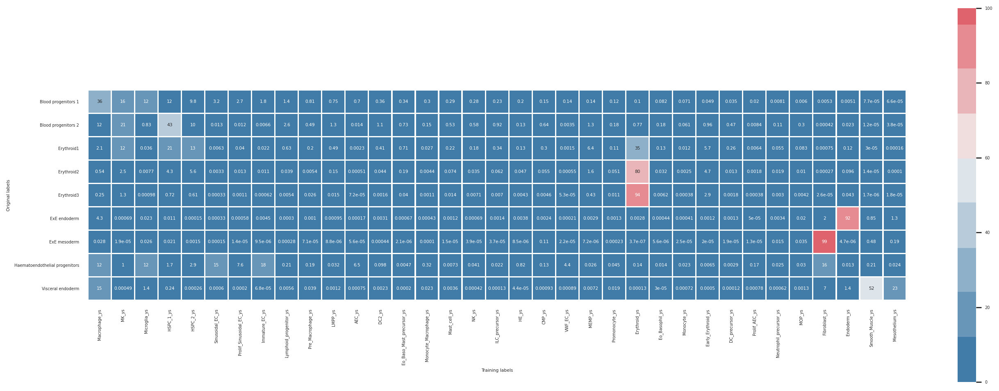

In [95]:
model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()
# Sort df columns by rows
crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.4)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=60, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
#plt.savefig("./lr_outs/lr_plot_combined",dpi=200)

# Trimed probability plot

In [325]:
#pred_out['orig_labels']  = pred_out['orig_labels'].str.replace('_\d+_','_').astype(str)

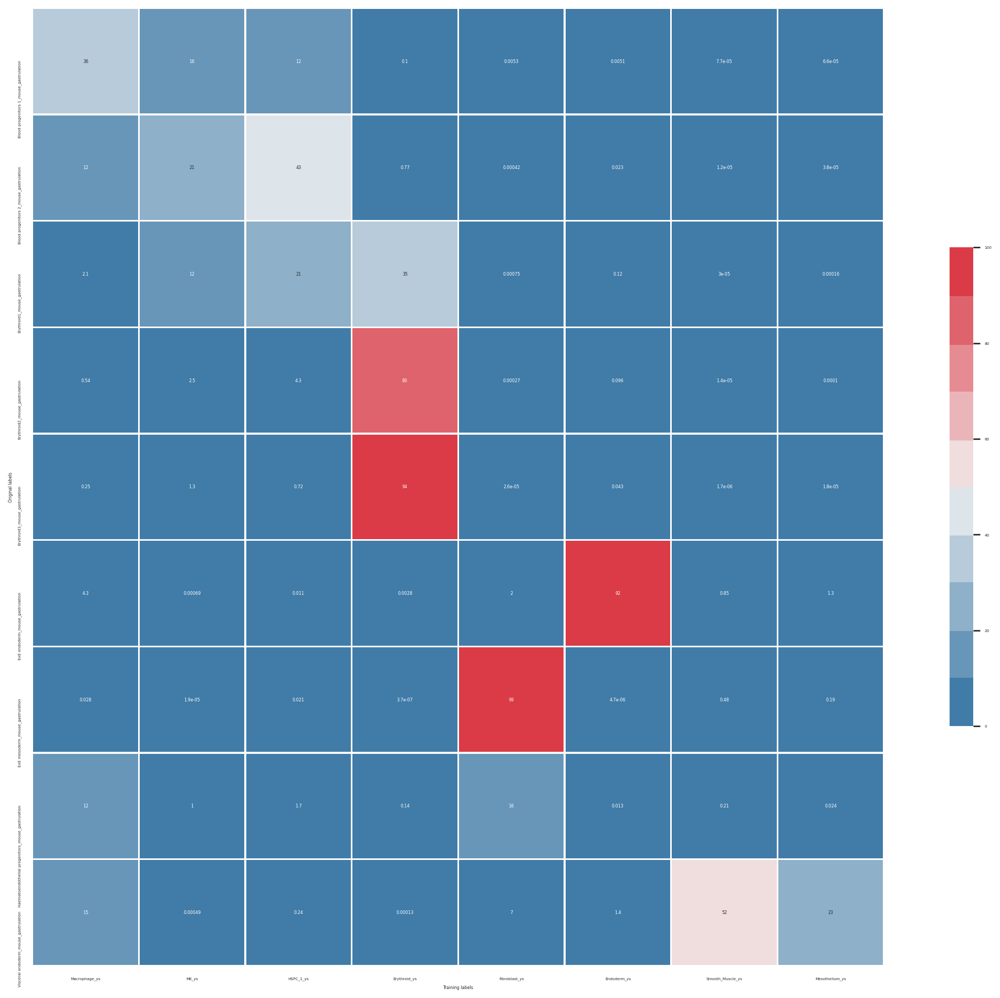

In [336]:
trim = 20

model_mean_probs = pred_out.loc[:, pred_out.columns != 'predicted'].groupby('orig_labels').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()
# Sort df columns by rows
crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
crs_tbl = crs_tbl[crs_tbl.columns[crs_tbl.max() > trim]]
# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.3)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple",dpi=200)

# Frequency redistribution of predicted labels within blood progen and ery lineages

# Plot prediction labels vs prediction data

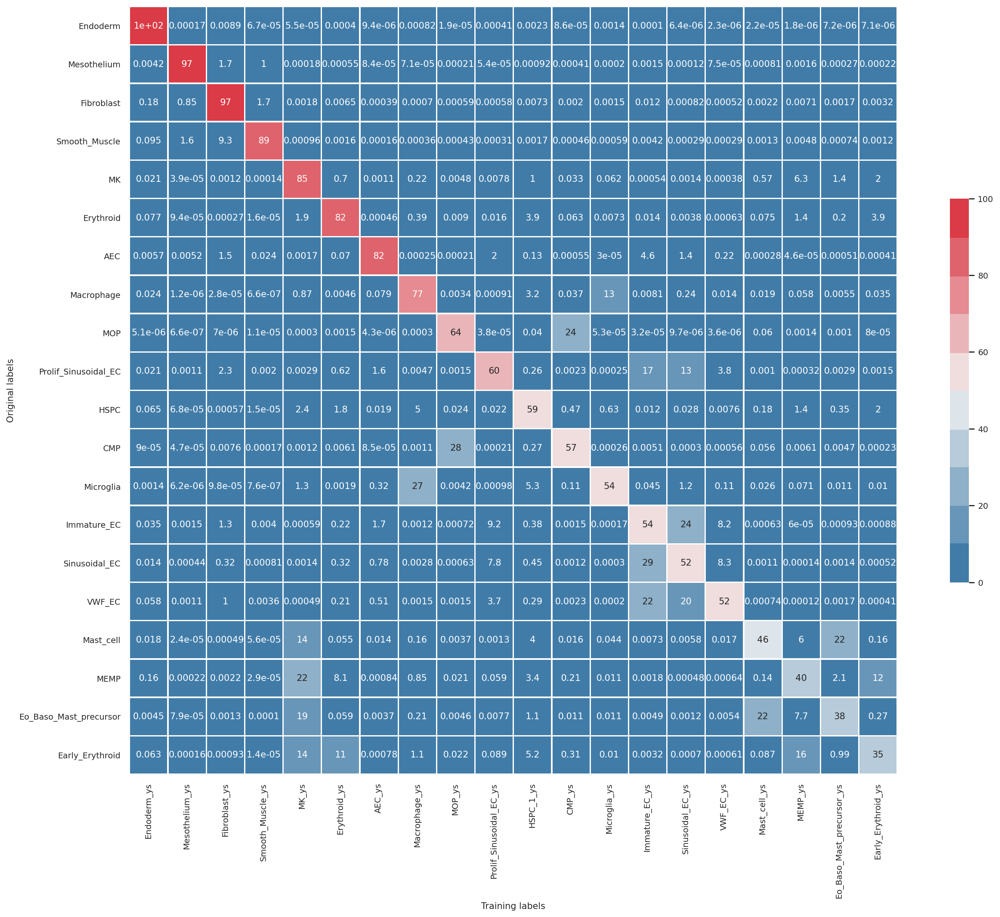

In [337]:
trim = 20

model_mean_probs = pred_out.loc[:, pred_out.columns != 'orig_labels'].groupby('predicted').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()
# Keep only predictions with probs >20
crs_tbl = crs_tbl[crs_tbl.columns[crs_tbl.max() > trim]]

# Keep only predicted labels with probs >20
crs_tbl = crs_tbl[crs_tbl.max(axis=1) > trim]

# Sort df columns by rows

#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.columns), axis=0,ascending=False)

index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple_trimmed_20_prob" , dpi=200)

In [526]:
pred_out['predicted'].value_counts()

Endoderm_ys                  4281
Erythroid_ys                 2525
Fibroblast_ys                1626
HSPC_1_ys                    1090
Macrophage_ys                 802
MK_ys                         483
Smooth_Muscle_ys              398
Immature_EC_ys                284
Sinusoidal_EC_ys              232
HSPC_2_ys                     221
Microglia_ys                  212
Mesothelium_ys                192
Prolif_Sinusoidal_EC_ys       108
AEC_ys                         99
MEMP_ys                        75
Early_Erythroid_ys             29
VWF_EC_ys                      26
CMP_ys                         11
Mast_cell_ys                    6
MOP_ys                          5
Eo_Baso_Mast_precursor_ys       5
Name: predicted, dtype: int64

In [527]:
cluster_prediction = "clus_prediction"
clusters_reassign = "orig_labels"
lr_predicted_col = 'predicted'

reassign_classes = ['Blood progenitors 1_0_mouse_gastrulation',
 'Blood progenitors 1_1_mouse_gastrulation',
 'Blood progenitors 1_2_mouse_gastrulation',
 'Blood progenitors 1_3_mouse_gastrulation',
 'Blood progenitors 2_0_mouse_gastrulation',
 'Blood progenitors 2_1_mouse_gastrulation',
 'Blood progenitors 2_2_mouse_gastrulation',
 'Blood progenitors 2_3_mouse_gastrulation',
 'Blood progenitors 2_4_mouse_gastrulation',
 'Blood progenitors 2_5_mouse_gastrulation',
 'Erythroid1_0_mouse_gastrulation',
 'Erythroid1_1_mouse_gastrulation',
 'Erythroid1_2_mouse_gastrulation',
 'Erythroid1_3_mouse_gastrulation',
 'Erythroid2_0_mouse_gastrulation',
 'Erythroid2_1_mouse_gastrulation',
 'Erythroid2_2_mouse_gastrulation',
 'Erythroid2_3_mouse_gastrulation',
 'Erythroid3_0_mouse_gastrulation',
 'Erythroid3_1_mouse_gastrulation',
 'Erythroid3_2_mouse_gastrulation',
 'Erythroid3_3_mouse_gastrulation']

In [528]:
np.median(pred_out['predicted'].value_counts())

212.0

### Define some classifier rules:
- Only classes inside blood proegn and erytrhoid are considered for reclassification
- Classified labels are measured for 68% CI and labels above this distributed are considered

# Frequency redistribution with sub distribution for classes >65CI 
Assign all to top category by deafult, then assign each of the remaining > 68CI annotations

In [529]:
pred_out = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/lr_outs/pred_out.csv',index_col = 0)

In [530]:
freq_arranged 

Index(['Erythroid_ys'], dtype='object')

In [531]:
lm = 1 # lambda value
pred_out[cluster_prediction] = pred_out[clusters_reassign]
for z in pred_out[clusters_reassign][pred_out[clusters_reassign].isin(reassign_classes)].unique():
    df = pred_out
    df = df[(df[clusters_reassign].isin([z]))]
    df_count = pd.DataFrame(df[lr_predicted_col].value_counts())
    print(z)
# Look for classificationds > 68CI
    if len(df_count) > 1:
        df_count_temp = df_count[df_count[lr_predicted_col]>int(int(df_count.mean()) + (df_count.std()*lm))]
        if len(df_count_temp >= 1):
            df_count = df_count_temp
    print(df_count)     
    freq_arranged = df_count.index
    cat = freq_arranged[0]
    #df.loc[:,cluster_prediction] = cat
#Make the cluster assignment first
    cat = cat.replace('_ys','') + '_lineage_mouse_gastrulation'
    pred_out.loc[pred_out[clusters_reassign] == z, [cluster_prediction]] = cat
    print(cat)
# Create assignments for any classification >68CI
    for cats in freq_arranged:
        print(cats)
        cats_assignment = cats.replace('_ys','') + '_lineage_mouse_gastrulation'
        pred_out.loc[(pred_out[clusters_reassign] == z) & (pred_out[lr_predicted_col] == cats),[cluster_prediction]] = cats_assignment 


Blood progenitors 2_2_mouse_gastrulation
           predicted
HSPC_1_ys        123
HSPC_1_lineage_mouse_gastrulation
HSPC_1_ys
Blood progenitors 2_3_mouse_gastrulation
           predicted
HSPC_1_ys        139
HSPC_1_lineage_mouse_gastrulation
HSPC_1_ys
Blood progenitors 1_0_mouse_gastrulation
               predicted
Macrophage_ys         72
Macrophage_lineage_mouse_gastrulation
Macrophage_ys
Erythroid1_2_mouse_gastrulation
              predicted
Erythroid_ys        130
HSPC_1_ys           116
Erythroid_lineage_mouse_gastrulation
Erythroid_ys
HSPC_1_ys
Blood progenitors 1_1_mouse_gastrulation
               predicted
Macrophage_ys         37
Macrophage_lineage_mouse_gastrulation
Macrophage_ys
Blood progenitors 2_5_mouse_gastrulation
       predicted
MK_ys         23
MK_lineage_mouse_gastrulation
MK_ys
Blood progenitors 2_1_mouse_gastrulation
           predicted
HSPC_1_ys        206
HSPC_1_lineage_mouse_gastrulation
HSPC_1_ys
Blood progenitors 2_0_mouse_gastrulation
           predic

In [532]:
pred_out

,predicted,orig_labels,AEC_ys,CMP_ys,DC2_ys,DC_precursor_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,...,NK_ys,Neutrophil_precursor_ys,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys,clus_prediction
cell_55,Endoderm_ys,ExE endoderm_2_mouse_gastrulation,2.952576e-08,1.277242e-07,3.705876e-08,2.909080e-08,2.365610e-09,0.999997,6.140164e-09,2.658687e-09,...,1.757945e-09,1.935596e-07,6.747414e-11,9.668234e-10,1.779612e-08,1.393473e-07,1.166292e-08,2.965052e-09,4.641290e-08,ExE endoderm_2_mouse_gastrulation
cell_56,Endoderm_ys,ExE endoderm_2_mouse_gastrulation,8.056650e-09,2.276891e-08,9.599423e-09,6.605752e-09,3.776414e-09,0.999998,7.300582e-10,6.964098e-10,...,3.068943e-10,2.556830e-08,6.559464e-12,4.124715e-10,1.045007e-08,2.312116e-08,4.246720e-10,1.687673e-10,5.329385e-10,ExE endoderm_2_mouse_gastrulation
cell_58,Fibroblast_ys,ExE endoderm_4_mouse_gastrulation,8.382406e-07,2.750313e-07,1.978302e-06,4.986804e-07,7.311766e-07,0.000006,1.382683e-06,1.199569e-06,...,7.306753e-07,2.613544e-06,8.773851e-07,1.066933e-07,2.740536e-08,1.357253e-05,6.702385e-08,2.028924e-01,6.356617e-08,ExE endoderm_4_mouse_gastrulation
cell_64,Smooth_Muscle_ys,Visceral endoderm_3_mouse_gastrulation,4.114258e-07,2.932696e-07,7.443148e-07,1.701981e-05,2.118401e-06,0.000175,2.088323e-06,1.943852e-06,...,1.457638e-06,4.739591e-06,1.533548e-07,2.586294e-07,5.704435e-08,2.863325e-06,3.829288e-08,7.576674e-01,8.109397e-07,Visceral endoderm_3_mouse_gastrulation
cell_73,Endoderm_ys,ExE endoderm_0_mouse_gastrulation,3.042281e-08,3.991330e-08,1.133669e-08,4.649458e-08,3.693418e-09,0.999989,2.447281e-08,1.231131e-08,...,1.869090e-09,1.725943e-07,3.647839e-10,3.499126e-09,9.391464e-08,1.772299e-07,1.092646e-08,3.894507e-09,3.748276e-09,ExE endoderm_0_mouse_gastrulation
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
cell_139315,Erythroid_ys,Erythroid1_3_mouse_gastrulation,8.576677e-06,8.613203e-04,3.857434e-04,1.445305e-04,3.089503e-02,0.000950,3.648055e-03,4.276404e-04,...,1.161128e-03,2.836420e-04,1.384662e-05,1.267524e-05,4.589572e-05,8.382999e-04,1.580399e-05,5.312027e-07,1.290885e-05,Erythroid_lineage_mouse_gastrulation
cell_139321,Erythroid_ys,Erythroid3_1_mouse_gastrulation,4.326428e-07,2.829899e-05,2.745955e-06,1.735684e-05,2.844559e-02,0.000151,4.674802e-04,3.680631e-05,...,6.594341e-05,2.041192e-05,4.528708e-05,2.262853e-06,3.215648e-06,5.386145e-05,2.239609e-06,7.498989e-09,2.457512e-07,Erythroid_lineage_mouse_gastrulation
cell_139326,Erythroid_ys,Erythroid3_0_mouse_gastrulation,4.711104e-07,5.210914e-05,7.196588e-06,1.997274e-05,1.609372e-02,0.000386,2.664453e-04,1.067933e-04,...,1.019054e-04,2.720630e-05,5.201813e-05,2.655923e-06,8.564704e-06,1.061942e-04,2.914583e-06,6.881123e-09,3.139425e-07,Erythroid_lineage_mouse_gastrulation
cell_139327,Erythroid_ys,Erythroid3_1_mouse_gastrulation,4.430987e-07,5.414425e-05,5.781459e-06,1.512979e-05,9.738686e-03,0.000418,4.346512e-04,6.747152e-05,...,1.059576e-04,5.811490e-05,1.819468e-05,3.338364e-06,6.256974e-06,7.775825e-05,1.060743e-06,5.980478e-09,1.966100e-07,Erythroid_lineage_mouse_gastrulation


In [533]:
# reassign prediction columns
pred_out[lr_predicted_col] = pred_out[cluster_prediction][:]
del pred_out[cluster_prediction]
pred_out
# remove subclusters
pred_out['orig_labels']  = pred_out['orig_labels'].str.replace('_\d+_','_').astype(str)
pred_out['predicted']  = pred_out['predicted'].str.replace('_\d+_','_').astype(str)
pred_out['predicted']  = pred_out['predicted'].str.replace('_ys','').astype(str)
pred_out

<ipython-input-533-53c4bdc165d7>:6: FutureWarning: The default value of regex will change from True to False in a future version.
  pred_out['orig_labels']  = pred_out['orig_labels'].str.replace('_\d+_','_').astype(str)
<ipython-input-533-53c4bdc165d7>:7: FutureWarning: The default value of regex will change from True to False in a future version.
  pred_out['predicted']  = pred_out['predicted'].str.replace('_\d+_','_').astype(str)


,predicted,orig_labels,AEC_ys,CMP_ys,DC2_ys,DC_precursor_ys,Early_Erythroid_ys,Endoderm_ys,Eo_Baso_Mast_precursor_ys,Eo_Basophil_ys,...,Monocyte_ys,NK_ys,Neutrophil_precursor_ys,Pre_Macrophage_ys,Prolif_AEC_ys,Prolif_Sinusoidal_EC_ys,Promonocyte_ys,Sinusoidal_EC_ys,Smooth_Muscle_ys,VWF_EC_ys
cell_55,ExE endoderm_mouse_gastrulation,ExE endoderm_mouse_gastrulation,2.952576e-08,1.277242e-07,3.705876e-08,2.909080e-08,2.365610e-09,0.999997,6.140164e-09,2.658687e-09,...,2.944074e-08,1.757945e-09,1.935596e-07,6.747414e-11,9.668234e-10,1.779612e-08,1.393473e-07,1.166292e-08,2.965052e-09,4.641290e-08
cell_56,ExE endoderm_mouse_gastrulation,ExE endoderm_mouse_gastrulation,8.056650e-09,2.276891e-08,9.599423e-09,6.605752e-09,3.776414e-09,0.999998,7.300582e-10,6.964098e-10,...,1.663741e-09,3.068943e-10,2.556830e-08,6.559464e-12,4.124715e-10,1.045007e-08,2.312116e-08,4.246720e-10,1.687673e-10,5.329385e-10
cell_58,ExE endoderm_mouse_gastrulation,ExE endoderm_mouse_gastrulation,8.382406e-07,2.750313e-07,1.978302e-06,4.986804e-07,7.311766e-07,0.000006,1.382683e-06,1.199569e-06,...,2.001801e-06,7.306753e-07,2.613544e-06,8.773851e-07,1.066933e-07,2.740536e-08,1.357253e-05,6.702385e-08,2.028924e-01,6.356617e-08
cell_64,Visceral endoderm_mouse_gastrulation,Visceral endoderm_mouse_gastrulation,4.114258e-07,2.932696e-07,7.443148e-07,1.701981e-05,2.118401e-06,0.000175,2.088323e-06,1.943852e-06,...,1.504758e-06,1.457638e-06,4.739591e-06,1.533548e-07,2.586294e-07,5.704435e-08,2.863325e-06,3.829288e-08,7.576674e-01,8.109397e-07
cell_73,ExE endoderm_mouse_gastrulation,ExE endoderm_mouse_gastrulation,3.042281e-08,3.991330e-08,1.133669e-08,4.649458e-08,3.693418e-09,0.999989,2.447281e-08,1.231131e-08,...,6.219170e-08,1.869090e-09,1.725943e-07,3.647839e-10,3.499126e-09,9.391464e-08,1.772299e-07,1.092646e-08,3.894507e-09,3.748276e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
cell_139315,Erythroid_lineage_mouse_gastrulation,Erythroid1_mouse_gastrulation,8.576677e-06,8.613203e-04,3.857434e-04,1.445305e-04,3.089503e-02,0.000950,3.648055e-03,4.276404e-04,...,4.915620e-05,1.161128e-03,2.836420e-04,1.384662e-05,1.267524e-05,4.589572e-05,8.382999e-04,1.580399e-05,5.312027e-07,1.290885e-05
cell_139321,Erythroid_lineage_mouse_gastrulation,Erythroid3_mouse_gastrulation,4.326428e-07,2.829899e-05,2.745955e-06,1.735684e-05,2.844559e-02,0.000151,4.674802e-04,3.680631e-05,...,2.873138e-06,6.594341e-05,2.041192e-05,4.528708e-05,2.262853e-06,3.215648e-06,5.386145e-05,2.239609e-06,7.498989e-09,2.457512e-07
cell_139326,Erythroid_lineage_mouse_gastrulation,Erythroid3_mouse_gastrulation,4.711104e-07,5.210914e-05,7.196588e-06,1.997274e-05,1.609372e-02,0.000386,2.664453e-04,1.067933e-04,...,4.529629e-06,1.019054e-04,2.720630e-05,5.201813e-05,2.655923e-06,8.564704e-06,1.061942e-04,2.914583e-06,6.881123e-09,3.139425e-07
cell_139327,Erythroid_lineage_mouse_gastrulation,Erythroid3_mouse_gastrulation,4.430987e-07,5.414425e-05,5.781459e-06,1.512979e-05,9.738686e-03,0.000418,4.346512e-04,6.747152e-05,...,4.037572e-06,1.059576e-04,5.811490e-05,1.819468e-05,3.338364e-06,6.256974e-06,7.775825e-05,1.060743e-06,5.980478e-09,1.966100e-07


In [534]:
pred_out['predicted'].value_counts()

ExE endoderm_mouse_gastrulation                      4670
Erythroid_lineage_mouse_gastrulation                 2799
HSPC_lineage_mouse_gastrulation                      1460
Haematoendothelial progenitors_mouse_gastrulation    1365
ExE mesoderm_mouse_gastrulation                      1286
Visceral endoderm_mouse_gastrulation                  640
MK_lineage_mouse_gastrulation                         246
Macrophage_lineage_mouse_gastrulation                 244
Name: predicted, dtype: int64

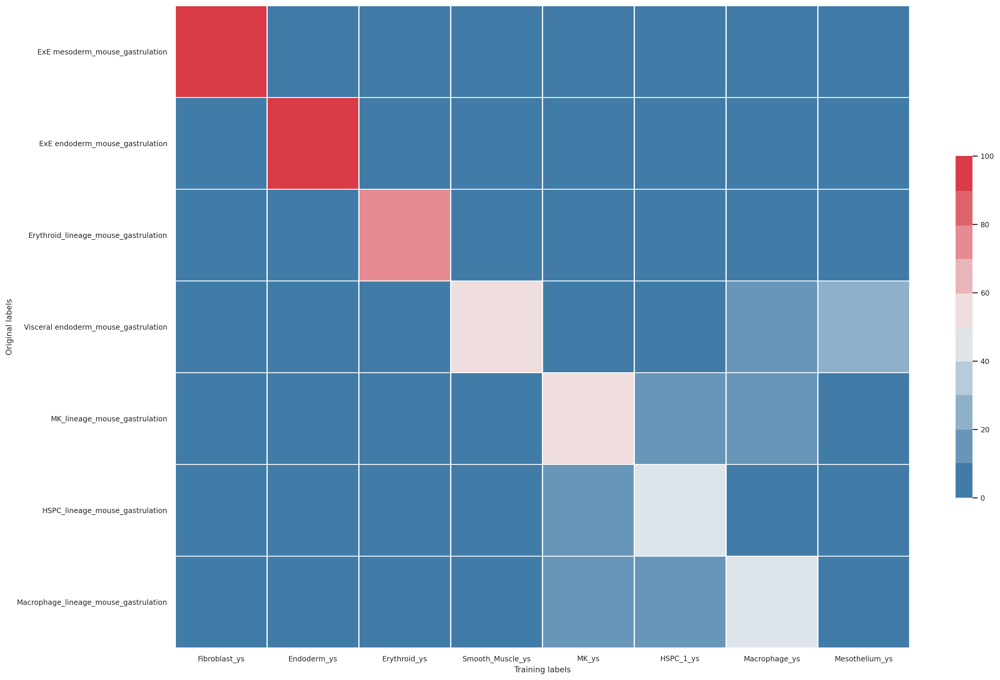

In [535]:
trim = 20

model_mean_probs = pred_out.loc[:, pred_out.columns != 'orig_labels'].groupby('predicted').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()
# Keep only predictions with probs >20
crs_tbl = crs_tbl[crs_tbl.columns[crs_tbl.max() > trim]]

# Keep only predicted labels with probs >20
crs_tbl = crs_tbl[crs_tbl.max(axis=1) > trim]

# Sort df columns by rows

#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.columns), axis=0,ascending=False)

index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=False,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple_trimmed_20_prob.pdf" , dpi=200)

In [836]:
crs_tbl = pd.read_csv('edit.csv',index_col=0)

In [837]:
list(crs_tbl.index)

['ExE mesoderm_mouse_gastrulation',
 'ExE endoderm_mouse_gastrulation',
 'Erythroid_lineage_mouse_gastrulation',
 'Visceral endoderm_mouse_gastrulation',
 'MK_lineage_mouse_gastrulation',
 'HSPC_lineage_mouse_gastrulation',
 'Macrophage_lineage_mouse_gastrulation',
 'Haematoendothelial progenitors_mouse_gastrulation']

In [838]:
list(crs_tbl.columns)

['Fibroblast_ys',
 'Endoderm_ys',
 'Erythroid_ys',
 'Smooth_Muscle_ys',
 'MK_ys',
 'HSPC_1_ys',
 'Macrophage_ys',
 'Mesothelium_ys',
 'Immature_EC_ys',
 'Sinusoidal_EC_ys',
 'Microglia_ys',
 'HSPC_2_ys',
 'Prolif_Sinusoidal_EC_ys',
 'AEC_ys',
 'VWF_EC_ys',
 'Early_Erythroid_ys',
 'MEMP_ys',
 'Lymphoid_progenitor_ys',
 'LMPP_ys',
 'DC2_ys',
 'Pre_Macrophage_ys',
 'ILC_precursor_ys',
 'HE_ys',
 'Eo_Baso_Mast_precursor_ys',
 'CMP_ys',
 'DC_precursor_ys',
 'NK_ys',
 'Mast_cell_ys',
 'Monocyte_Macrophage_ys',
 'MOP_ys',
 'Promonocyte_ys',
 'Eo_Basophil_ys',
 'Prolif_AEC_ys',
 'Neutrophil_precursor_ys',
 'Monocyte_ys']

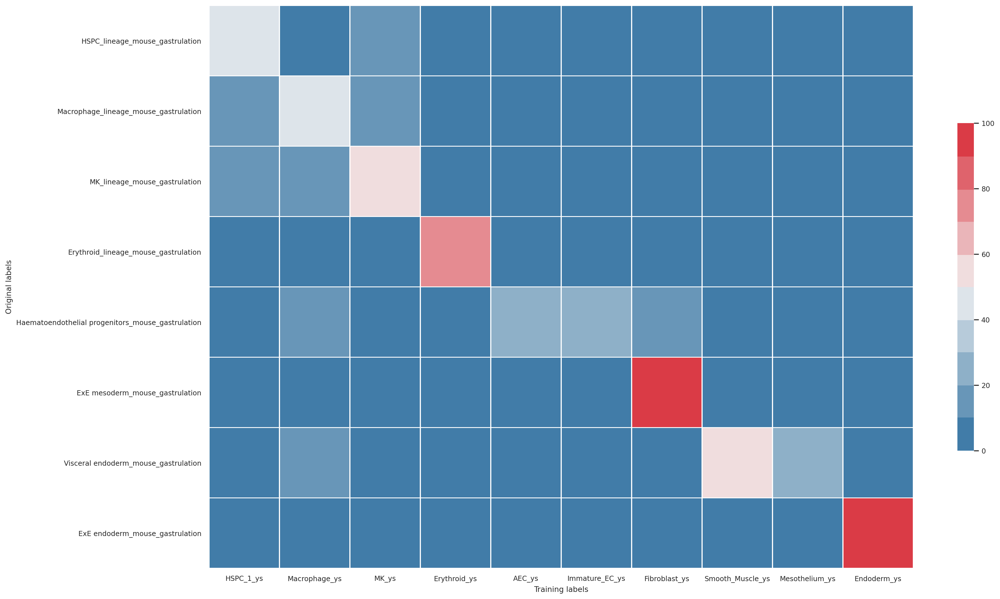

In [840]:
trim = 20

model_mean_probs = pred_out.loc[:, pred_out.columns != 'orig_labels'].groupby('predicted').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()

crs_tbl = pd.read_csv('edit.csv',index_col=0)
# Keep only predictions with probs >20
#crs_tbl = crs_tbl[crs_tbl.columns[crs_tbl.max() > trim]]

# Keep only predicted labels with probs >20
#crs_tbl = crs_tbl[crs_tbl.max(axis=1) > trim]

# Sort df columns by rows

#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.columns), axis=0,ascending=False)

index_order = ['HSPC_lineage_mouse_gastrulation',
  'Macrophage_lineage_mouse_gastrulation',
                 'MK_lineage_mouse_gastrulation',
 'Erythroid_lineage_mouse_gastrulation',
              'Haematoendothelial progenitors_mouse_gastrulation',
 'ExE mesoderm_mouse_gastrulation',
  'Visceral endoderm_mouse_gastrulation', 
               'ExE endoderm_mouse_gastrulation',]
col_order = [ 'HSPC_1_ys',
'Macrophage_ys',
 'MK_ys',
 'Erythroid_ys',
'AEC_ys',
'Immature_EC_ys',
'Fibroblast_ys',
'Smooth_Muscle_ys',
 'Mesothelium_ys',
 'Endoderm_ys',]
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=False,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple_trimmed_20_prob_reordered.pdf" , dpi=200)

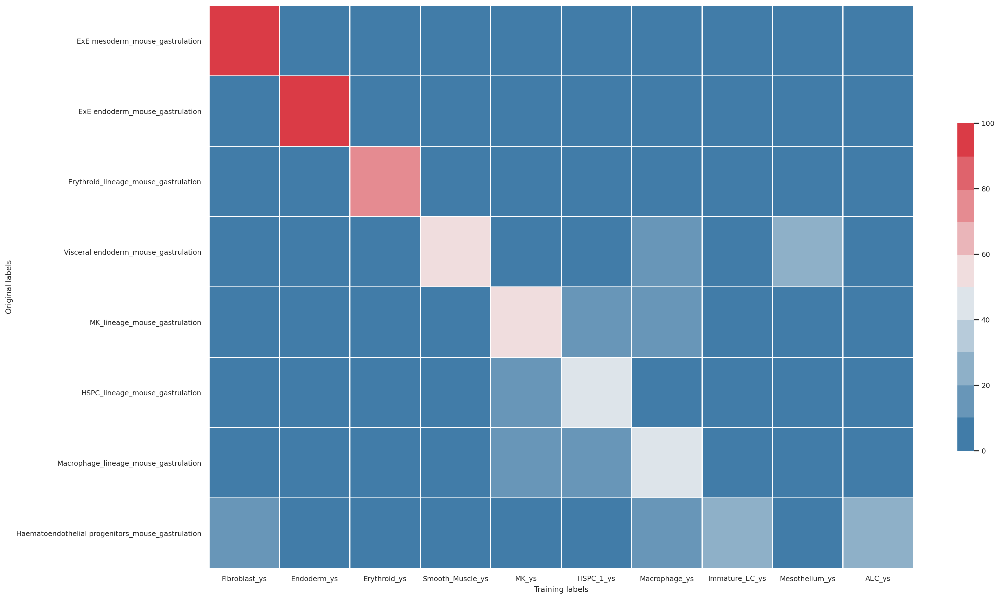

In [887]:
#crs_tbl.to_csv('edit.csv')
crs_tbl = pd.read_csv('edit.csv',index_col=0)
# Keep only predictions with probs >20
crs_tbl = crs_tbl[crs_tbl.columns[crs_tbl.max() > trim]]

# Keep only predicted labels with probs >20
crs_tbl = crs_tbl[crs_tbl.max(axis=1) > trim]

# Sort df columns by rows

#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.columns), axis=0,ascending=False)

index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=False,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple_trimmed_20_prob.pdf" , dpi=200)

Text(0.5, 569.0357142857142, 'Training labels')

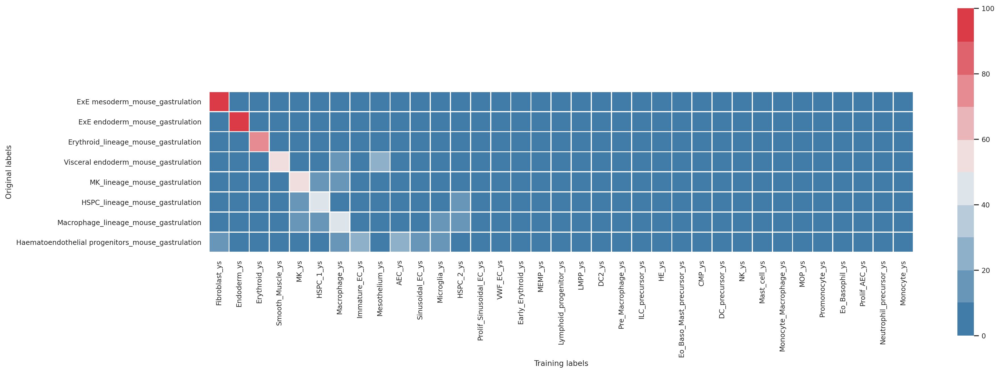

In [541]:
#crs_tbl.to_csv('edit.csv')
crs_tbl = pd.read_csv('edit.csv',index_col=0)

index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=False,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")

# Create broad categorisation for broad LR

In [881]:
crs_tbl.columns

Index(['DC_YS', 'ENDODERM_YS', 'ENDOTHELIUM_YS', 'ERYTHROID_YS',
       'FIBROBLAST_YS', 'GRANULOCYTE_PRECURSORS_YS', 'LYMPHOID_YS',
       'MACROPHAGE_YS', 'MAST_CELL_YS', 'MESOTHELIUM_YS', 'MICROGLIA_YS',
       'MK_YS', 'MONOCYTE_YS', 'PROGENITORS_YS', 'SMOOTH_MUSCLE_YS'],
      dtype='object', name='predicted')

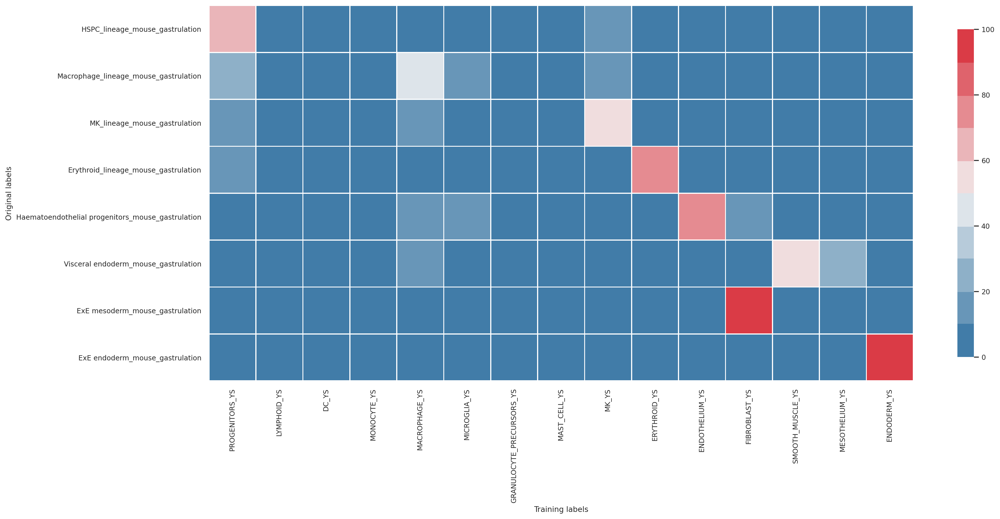

In [886]:
crs_tbl = pd.read_csv('edit.csv',index_col=0)
broad_mapper = dict(zip(adata.obs['corr_concat'],adata.obs['species_celltype']))
tmp = crs_tbl.T
tmp['predicted'] = tmp.index.values
tmp['predicted'] = tmp['predicted'].map(broad_mapper)
tmp = tmp.groupby(['predicted']).agg('sum').reset_index()
tmp.index = tmp['predicted']
del tmp['predicted']
tmp = tmp.T
tmp


#crs_tbl.to_csv('edit.csv')
crs_tbl = tmp
index_order = ['HSPC_lineage_mouse_gastrulation',
  'Macrophage_lineage_mouse_gastrulation',
                 'MK_lineage_mouse_gastrulation',
 'Erythroid_lineage_mouse_gastrulation',
              'Haematoendothelial progenitors_mouse_gastrulation',
  'Visceral endoderm_mouse_gastrulation', 
 'ExE mesoderm_mouse_gastrulation',
               'ExE endoderm_mouse_gastrulation',]
col_order = [ 'PROGENITORS_YS',
 'LYMPHOID_YS',
'DC_YS',
 'MONOCYTE_YS',
 'MACROPHAGE_YS',
 'MICROGLIA_YS',
'GRANULOCYTE_PRECURSORS_YS',
 'MAST_CELL_YS',
 'MK_YS',
 'ERYTHROID_YS',
 'ENDOTHELIUM_YS',
 'FIBROBLAST_YS',
'SMOOTH_MUSCLE_YS',
'MESOTHELIUM_YS',
 'ENDODERM_YS',
]
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=False,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple_no_trim_supp_broad_101121.pdf" , dpi=200)

In [870]:
crs_tbl.columns

Index(['HSPC_1_ys', 'Macrophage_ys', 'MK_ys', 'Erythroid_ys', 'AEC_ys',
       'Immature_EC_ys', 'Fibroblast_ys', 'Smooth_Muscle_ys', 'Mesothelium_ys',
       'Endoderm_ys'],
      dtype='object')

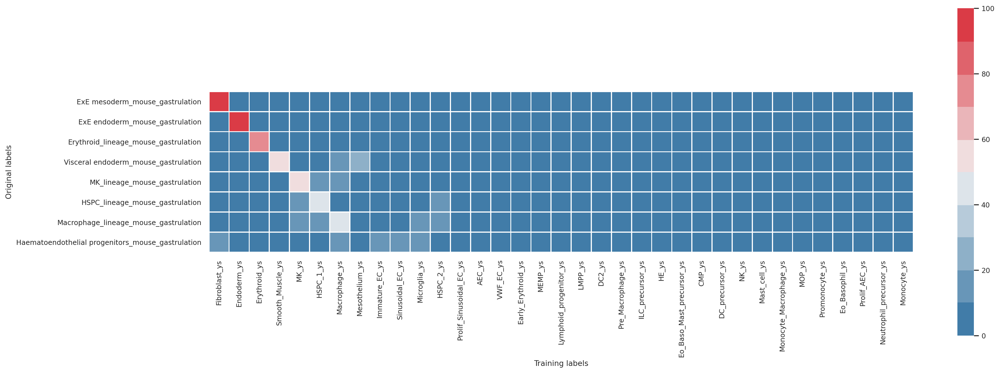

In [537]:
trim = 20

model_mean_probs = pred_out.loc[:, pred_out.columns != 'orig_labels'].groupby('predicted').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()


#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.columns), axis=0,ascending=False)

index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=False,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple_no_trim_supp.pdf" , dpi=200)

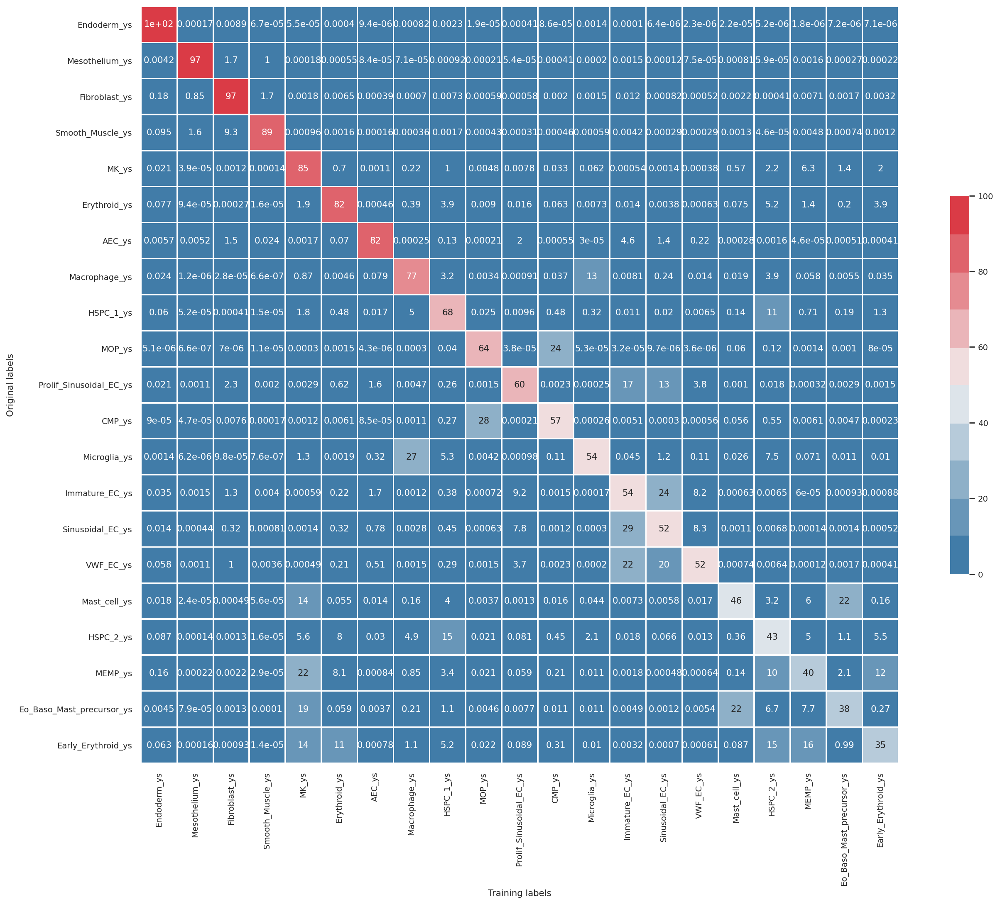

In [318]:
trim = 20

model_mean_probs = pred_out.loc[:, pred_out.columns != 'orig_labels'].groupby('predicted').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()
# Keep only predictions with probs >20
crs_tbl = crs_tbl[crs_tbl.columns[crs_tbl.max() > trim]]

# Keep only predicted labels with probs >20
crs_tbl = crs_tbl[crs_tbl.max(axis=1) > trim]

# Sort df columns by rows

#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.columns), axis=0,ascending=False)

index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple_trimmed_20_prob" , dpi=200)

# UPdate adata annots using updated mouse_annotations

In [764]:
adata_ms_diff.obs['predicted'] = adata_ms_diff.obs['predicted'].astype(str)
adata_ms_diff.obs['predicted'] = adata_ms_diff.obs['predicted'].str.replace('CMP_lineage_mouse_gastrulation','MK_lineage_mouse_gastrulation')

adata_ms_dff.obs['predicted'].value_counts()

Erythroid_lineage_mouse_gastrulation     2599
HSPC_1_lineage_mouse_gastrulation         928
MK_lineage_mouse_gastrulation             649
Macrophage_lineage_mouse_gastrulation     525
CMP_lineage_mouse_gastrulation             16
Name: predicted, dtype: int64

In [765]:
adata.obs['corr_concat'] = adata.obs['corr_concat'].astype(str)
adata.obs.loc[adata.obs.index.isin(adata_ms_dff.obs.index),'corr_concat'] = adata_ms_dff.obs['predicted']
adata.obs['corr_concat'] = adata.obs['corr_concat'].str.replace('HSPC_1_lineage_mouse_gastrulation','HSPC_lineage_mouse_gastrulation')

In [766]:
adata.obs.loc[adata.obs.index.isin(adata_ms_dff.obs.index),'corr_concat'].unique()

array(['HSPC_lineage_mouse_gastrulation',
       'Macrophage_lineage_mouse_gastrulation',
       'MK_lineage_mouse_gastrulation',
       'Erythroid_lineage_mouse_gastrulation',
       'CMP_lineage_mouse_gastrulation'], dtype=object)

In [767]:
# remove subclusters
adata.obs.loc[adata.obs['species'].isin(['Mouse']),'corr_concat'] = adata.obs.loc[adata.obs['species'].isin(['Mouse']),'corr_concat'].str.replace('_\d+_','_').astype(str)
adata.obs.loc[adata.obs['species'].isin(['Mouse']),'corr_concat']

<ipython-input-767-d83eb4ee5cb1>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  adata.obs.loc[adata.obs['species'].isin(['Mouse']),'corr_concat'] = adata.obs.loc[adata.obs['species'].isin(['Mouse']),'corr_concat'].str.replace('_\d+_','_').astype(str)


cell_55             ExE endoderm_mouse_gastrulation
cell_56             ExE endoderm_mouse_gastrulation
cell_58             ExE endoderm_mouse_gastrulation
cell_64        Visceral endoderm_mouse_gastrulation
cell_73             ExE endoderm_mouse_gastrulation
                               ...                 
cell_139315    Erythroid_lineage_mouse_gastrulation
cell_139321    Erythroid_lineage_mouse_gastrulation
cell_139326    Erythroid_lineage_mouse_gastrulation
cell_139327    Erythroid_lineage_mouse_gastrulation
cell_139330    Erythroid_lineage_mouse_gastrulation
Name: corr_concat, Length: 12710, dtype: object

# Plot overall UMAP

#### Remove categories which are not important

In [768]:
remove = ['Blood progenitors 1_mouse_gastrulation', 'Blood progenitors 2_mouse_gastrulation',
 'CMP_lineage_mouse_gastrulation',
 'Erythroid3_mouse_gastrulation',]
adata = adata[~adata.obs['corr_concat'].isin(remove)]

In [769]:
adata[adata.obs['corr_concat'].isin(remove)]

View of AnnData object with n_obs × n_vars = 0 × 1452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'celltype', 'species', 'species_donor', 'n_counts', 'restricted_celltype', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'cell_cycle_score', 'cat_index', 'batch', 'leiden'
    var: 'HGNC-0', 'ENSDB-0', 'mouse_human_homologs-0', 'DB Class Key_homogene_db-0', 'Common Organism Name_homogene_db-0', 'NCBI Taxon ID_homogene_db-0', 'Symbol_homogene_db-0', 'EntrezGene ID_homogene_db-0', 'Mouse MGI ID_homogene_db-0', 'HGNC ID_homogene_db-0', 'OMIM Gene ID_homogene_db-0', 'Genetic Location_homogene_db-0', 'Genomic Coordinates (mouse: , human: )_homogene_db-0', 'Nucleotide RefSeq IDs_homogene_db-0', 'Protein RefSeq IDs_homogene_db-0', 'SWISS_PROT IDs_homogene_db-0', 'n_cells-0', 'n_cells-1', 'mt-1', 'total_counts-1', 'highly_variable-1', 'intersect-1', 'means-1', 'disper

In [770]:
adata.obs.loc[adata.obs['species'].isin(['Mouse']),'corr_concat'].value_counts()

ExE endoderm_mouse_gastrulation                      4670
Erythroid_lineage_mouse_gastrulation                 2599
Haematoendothelial progenitors_mouse_gastrulation    1365
ExE mesoderm_mouse_gastrulation                      1286
HSPC_lineage_mouse_gastrulation                       928
MK_lineage_mouse_gastrulation                         649
Visceral endoderm_mouse_gastrulation                  640
Macrophage_lineage_mouse_gastrulation                 525
Name: corr_concat, dtype: int64

In [771]:
adata.write('adata_plotting_umap_091121.h5ad')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'corr_concat' as categorical


In [772]:
adata = sc.read('adata_plotting_umap_091121.h5ad')

In [773]:
var = "corr_concat"
key_add = 'species_celltype'
adata.obs[key_add] = adata.obs[var].astype(str)
adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add]  = adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add].str.replace('_\d+_','_').astype(str)
list(adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add].unique())

<ipython-input-773-b065a2dc7a47>:4: FutureWarning: The default value of regex will change from True to False in a future version.
  adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add]  = adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add].str.replace('_\d+_','_').astype(str)


['ExE endoderm_mouse_gastrulation',
 'Visceral endoderm_mouse_gastrulation',
 'HSPC_lineage_mouse_gastrulation',
 'Macrophage_lineage_mouse_gastrulation',
 'Haematoendothelial progenitors_mouse_gastrulation',
 'ExE mesoderm_mouse_gastrulation',
 'MK_lineage_mouse_gastrulation',
 'Erythroid_lineage_mouse_gastrulation']

### Remove DC from human data

In [774]:
remove = ['DC2_ys']
adata = adata[~adata.obs[key_add].isin(remove)]

### Change human lab§els to broad labels

In [775]:
adata.obs['species_broad_human'] = adata.obs['broad_cell.labels'].astype(str) + '_ys'
adata.obs.loc[adata.obs['species'].isin(['Human']),key_add] = adata.obs.loc[adata.obs['species'].isin(['Human']),'species_broad_human'] 

Trying to set attribute `.obs` of view, copying.


In [776]:
print(', '.join(list(adata.obs.loc[adata.obs['species'].isin(['Human']),key_add].unique())))

Endothelium_ys, Progenitors_ys, Endoderm_ys, Erythroid_ys, MK_ys, Mesothelium_ys, Fibroblast_ys, Macrophage_ys, Mast_cell_ys, DC_ys, Monocyte_ys, Granulocyte_precursors_ys, Microglia_ys, Smooth_Muscle_ys, Lymphoid_ys


In [777]:
adata.obs[key_add] = adata.obs[key_add].str.upper()

#### Ordering

In [778]:
# ordering
mouse = (list(adata.obs.loc[adata.obs['species'].isin(['Mouse']),key_add].unique()))
mouse = sorted(mouse)
human = (list(adata.obs.loc[adata.obs['species'].isin(['Human']),key_add].unique())) 
human = sorted(human)
plot_order = mouse + human
plot_order 

['ERYTHROID_LINEAGE_MOUSE_GASTRULATION',
 'EXE ENDODERM_MOUSE_GASTRULATION',
 'EXE MESODERM_MOUSE_GASTRULATION',
 'HAEMATOENDOTHELIAL PROGENITORS_MOUSE_GASTRULATION',
 'HSPC_LINEAGE_MOUSE_GASTRULATION',
 'MACROPHAGE_LINEAGE_MOUSE_GASTRULATION',
 'MK_LINEAGE_MOUSE_GASTRULATION',
 'VISCERAL ENDODERM_MOUSE_GASTRULATION',
 'DC_YS',
 'ENDODERM_YS',
 'ENDOTHELIUM_YS',
 'ERYTHROID_YS',
 'FIBROBLAST_YS',
 'GRANULOCYTE_PRECURSORS_YS',
 'LYMPHOID_YS',
 'MACROPHAGE_YS',
 'MAST_CELL_YS',
 'MESOTHELIUM_YS',
 'MICROGLIA_YS',
 'MK_YS',
 'MONOCYTE_YS',
 'PROGENITORS_YS',
 'SMOOTH_MUSCLE_YS']

In [779]:
# Col selector
col_selector = pd.DataFrame(data = [cells]).T
col_selector['col'] = ''
col_selector.columns = ['cells','col']
col_selector.to_csv('mouse_human_colour.csv')

In [789]:
sc.settings.set_figure_params(dpi=80, color_map='viridis',dpi_save=500, frameon=True, vector_friendly=True)
plt.rcParams['figure.figsize'] = [10, 10]

In [781]:
col_selector = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/human_mouse_pal_relabel_overall.csv')
col_selector = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/mouse_ys_broad_cell_labels_pal_091121.csv')
col_selector.iloc[:,0] = col_selector.iloc[:,0].str.upper()
col_selector = dict(zip(col_selector.iloc[:,0],col_selector.iloc[:,1]))

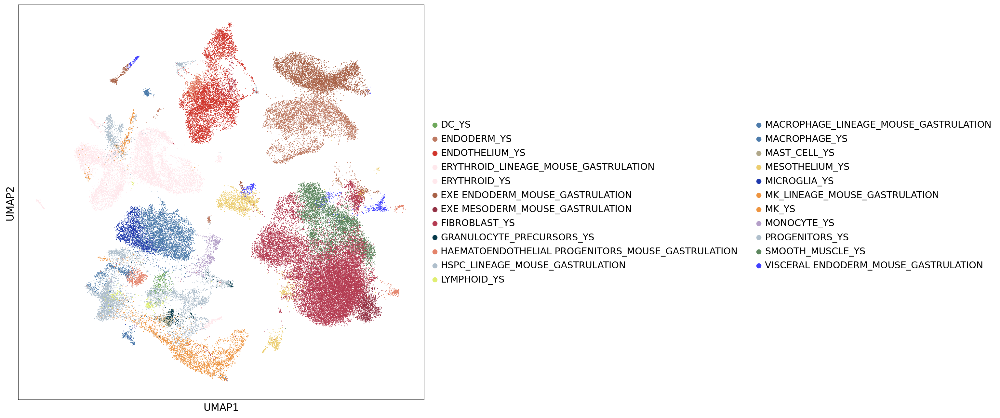

In [792]:
sc.pl.umap(adata, color = 'species_celltype' ,size = 5,show=True,title="", palette= col_selector, save= 'combined_human_mouse_broad.pdf')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'species_celltype_num' as categorical


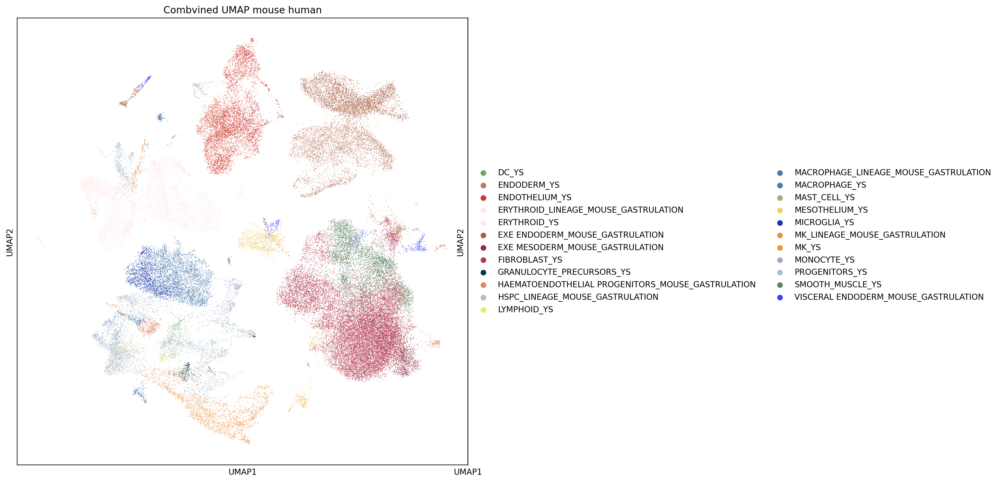

In [786]:
var = key_add
#Create color dictionary
cells = plot_order  #list(adata.obs[var].unique())
col = list(range(0,len(adata.obs[var].unique())))
dic = dict(zip(cells,col))

#Create a mappable field
adata.obs['num'] = adata.obs[var]
#map to adata.obs.col to create a caterorical column
adata.obs['num'] = adata.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata.obs['num'] = adata.obs['num'].astype(str)
adata.obs[var+'_num'] = adata.obs['num'].astype(str) + " : " + adata.obs[var].astype(str)

#col_pal = ['#ff0000',    '#94BFB1',    '#B49EC8',    '#E0EE70',    '#EE943E',    '#4C7BAB',    '#E78AB8',    '#AFBFCC',    '#FF993F',    "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",    "#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",    "#5A0007", "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF"]

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.umap(adata, color = var ,ax=ax2,show=False,title="", palette= col_selector ) #title=i
p3 = sc.pl.umap(adata, color = var,legend_loc=None,size=2,legend_fontsize='small',ax=ax1,show=False,title="Combvined UMAP mouse human", palette= col_selector) #title=i

fig.savefig('./'+var+"_combined_umap_mouse_human_with_numbers.pdf",bbox_inches='tight')

# 3 - Plot_species_umaps

#### Create a grey color scheme for either YS or Fliv

In [743]:
adata.obs['species_celltype'] = adata.obs['species_celltype'].str.upper()
#adata.obs['species_celltype'] = adata.obs['species_celltype'].str.replace(' ','')
adata.obs['species_celltype'] 

cell_55                                                 EXE ENDODERM_MOUSE_GASTRULATION
cell_56                                                 EXE ENDODERM_MOUSE_GASTRULATION
cell_58                                                 EXE ENDODERM_MOUSE_GASTRULATION
cell_64                                            VISCERAL ENDODERM_MOUSE_GASTRULATION
cell_73                                                 EXE ENDODERM_MOUSE_GASTRULATION
                                                                   ...                 
F80_Yolksac_Hep_FCAImmP8096696_TTTGCGCTCGCACTCT                           FIBROBLAST_YS
F80_Yolksac_Hep_FCAImmP8096696_TTTGGTTAGCTAGTCT                          MESOTHELIUM_YS
F80_Yolksac_Hep_FCAImmP8096696_TTTGTCAAGATGCCAG                          ENDOTHELIUM_YS
F80_Yolksac_Hep_FCAImmP8096696_TTTGTCAGTCGAACAG                          ENDOTHELIUM_YS
F80_Yolksac_Hep_FCAImmP8096696_TTTGTCATCGGATGGA                          MESOTHELIUM_YS
Name: species_celltype, Length: 

In [13]:
remove = ['Blood progenitors 1_mouse_gastrulation',
 'Blood progenitors 2_mouse_gastrulation','Erythroid1_mouse_gastrulation',
 'Erythroid2_mouse_gastrulation',
 'Erythroid3_mouse_gastrulation','Haematoendothelial progenitors_mouse_gastrulation',]
adata = adata[~adata.obs[key_add].isin(remove)]

In [744]:
plot_tissue = 'Human'
alternate_name = 'Mouse'

In [745]:
adata.obs["species"].unique()

['Mouse', 'Human']
Categories (2, object): ['Human', 'Mouse']

In [752]:
## Vars
adata_var = 'species_celltype'
col_pal = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/human_mouse_pal_relabel_overall.csv"
col_pal = '/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/mouse_ys_broad_cell_labels_pal_091121.csv'

col_selector = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/human_mouse_pal_relabel_overall.csv')
col_selector = dict(zip(col_selector.iloc[:,0],col_selector.iloc[:,1]))

col_selector = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/mouse_ys_broad_cell_labels_pal_091121.csv')
col_selector.iloc[:,0] = col_selector.iloc[:,0].str.upper()
col_selector = dict(zip(col_selector.iloc[:,0],col_selector.iloc[:,1]))

In [753]:
#Check if all cats are indeed available
pal = pd.read_csv(col_pal,index_col=None)
pal = pal.iloc[:,0:2]
pal.columns = ["categories",'color']
#Uppercase everything
pal = pal.apply(lambda x: x.astype(str).str.upper())
# Create a field to assign gray coloring to
adata.obs["var"] = adata.obs[adata_var].astype(str)
var = 'var'
adata.obs['var'] = adata.obs['var'].astype(str).str.upper()
adata.obs["var"].loc[~adata.obs["species"].isin([plot_tissue])] = alternate_name
#Not in intersect
intersecting = set(list(pal["categories"])) & set(list(adata.obs['var'].unique()))
print(len(intersecting),intersecting)
print("non_intersect",set(list(pal["categories"])) ^ set(list(adata.obs['var'].unique())))

15 {'ERYTHROID_YS', 'ENDOTHELIUM_YS', 'FIBROBLAST_YS', 'MAST_CELL_YS', 'MACROPHAGE_YS', 'MESOTHELIUM_YS', 'DC_YS', 'GRANULOCYTE_PRECURSORS_YS', 'PROGENITORS_YS', 'MICROGLIA_YS', 'LYMPHOID_YS', 'MK_YS', 'ENDODERM_YS', 'MONOCYTE_YS', 'SMOOTH_MUSCLE_YS'}
non_intersect {'EXE MESODERM_MOUSE_GASTRULATION', 'HAEMATOENDOTHELIAL PROGENITORS_MOUSE_GASTRULATION', 'Mouse', 'EXE ENDODERM_MOUSE_GASTRULATION', 'MACROPHAGE_LINEAGE_MOUSE_GASTRULATION', 'ERYTHROID_LINEAGE_MOUSE_GASTRULATION', 'HSPC_LINEAGE_MOUSE_GASTRULATION', 'MK_LINEAGE_MOUSE_GASTRULATION', 'VISCERAL ENDODERM_MOUSE_GASTRULATION'}


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [754]:
list(adata.obs['species_celltype'].unique())

['EXE ENDODERM_MOUSE_GASTRULATION',
 'VISCERAL ENDODERM_MOUSE_GASTRULATION',
 'BLOOD PROGENITORS 2_MOUSE_GASTRULATION',
 'HAEMATOENDOTHELIAL PROGENITORS_MOUSE_GASTRULATION',
 'BLOOD PROGENITORS 1_MOUSE_GASTRULATION',
 'EXE MESODERM_MOUSE_GASTRULATION',
 'ERYTHROID1_MOUSE_GASTRULATION',
 'ERYTHROID2_MOUSE_GASTRULATION',
 'ERYTHROID3_MOUSE_GASTRULATION',
 'ENDOTHELIUM_YS',
 'PROGENITORS_YS',
 'ENDODERM_YS',
 'ERYTHROID_YS',
 'MK_YS',
 'MESOTHELIUM_YS',
 'FIBROBLAST_YS',
 'MACROPHAGE_YS',
 'MAST_CELL_YS',
 'DC_YS',
 'MONOCYTE_YS',
 'GRANULOCYTE_PRECURSORS_YS',
 'MICROGLIA_YS',
 'SMOOTH_MUSCLE_YS',
 'LYMPHOID_YS']

In [755]:
cells

['DC_YS',
 'ENDODERM_YS',
 'ENDOTHELIUM_YS',
 'ERYTHROID_YS',
 'FIBROBLAST_YS',
 'GRANULOCYTE_PRECURSORS_YS',
 'LYMPHOID_YS',
 'MACROPHAGE_YS',
 'MAST_CELL_YS',
 'MESOTHELIUM_YS',
 'MICROGLIA_YS',
 'MK_YS',
 'MONOCYTE_YS',
 'PROGENITORS_YS',
 'SMOOTH_MUSCLE_YS']

In [756]:
pal

,categories,color
0,PROGENITORS_YS,#AFBFCC
1,LYMPHOID_YS,#E0EE71
2,DC_YS,#6EA85B
3,MONOCYTE_YS,#B49FC8
4,MACROPHAGE_YS,#4C7BAB
5,MICROGLIA_YS,#1E38AD
6,GRANULOCYTE_PRECURSORS_YS,#05394A
7,MAST_CELL_YS,#B0A789
8,MK_YS,#EE943F
9,ERYTHROID_YS,#FFE8EC


In [761]:
adata.obs[var].isin('DC_YS')

cell_55                                                     Mouse
cell_56                                                     Mouse
cell_58                                                     Mouse
cell_64                                                     Mouse
cell_73                                                     Mouse
                                                        ...      
F80_Yolksac_Hep_FCAImmP8096696_TTTGCGCTCGCACTCT     FIBROBLAST_YS
F80_Yolksac_Hep_FCAImmP8096696_TTTGGTTAGCTAGTCT    MESOTHELIUM_YS
F80_Yolksac_Hep_FCAImmP8096696_TTTGTCAAGATGCCAG    ENDOTHELIUM_YS
F80_Yolksac_Hep_FCAImmP8096696_TTTGTCAGTCGAACAG    ENDOTHELIUM_YS
F80_Yolksac_Hep_FCAImmP8096696_TTTGTCATCGGATGGA    MESOTHELIUM_YS
Name: var, Length: 66068, dtype: object

In [757]:
len(pal[pal["categories"].isin(cells)])

15

In [758]:
cells = list(adata.obs["var"][adata.obs["species"].isin([plot_tissue])].unique())
cells.sort()
pal = pal[pal["categories"].isin(cells)]
#cells.append(alternate_name)
col = list(range(0,len(cells)))
#Add gray color for alternate category
#pal.loc[len(pal)+1]= [alternate_name,"#808080"]
pal = pal.set_index('categories')
pal = pal.loc[cells]
col_pal = list(pal["color"])

In [759]:
#matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
#fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,1]})
#p2 = sc.pl.umap(adata[adata.obs["tissue"].isin([plot_tissue])], color = (var+'_num') ,ax=ax2,show=False,title="", palette= col_pal) #title=i
#p4 = sc.pl.umap(adata[~adata.obs["tissue"].isin([plot_tissue])], color = (var+'_num') ,ax=ax1,show=False,title="", palette= ["#808080"])
#p3 = sc.pl.umap(adata[adata.obs["tissue"].isin([plot_tissue])], color = "num",legend_loc="on data",size=2,legend_fontsize='small',ax=ax3,show=False,title="ys_broad", palette= col_pal) #title=i #title=i

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'species_celltype' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
Tryi

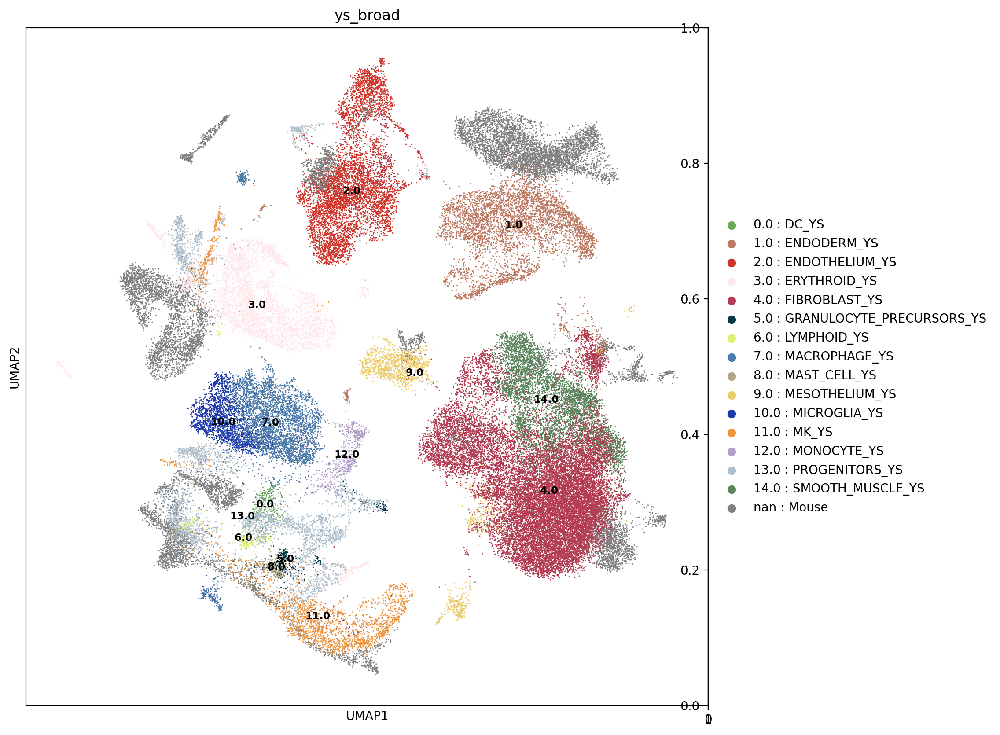

In [760]:
dic = dict(zip(cells,col))

#Create a mappable field
adata.obs['num'] = adata.obs[var]
#map to adata.obs.col to create a caterorical column
adata.obs['num'] = adata.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata.obs['num'] = adata.obs['num'].astype(str)
adata.obs[var+'_num'] = adata.obs['num'].astype(str) + " : " + adata.obs[var].astype(str)

import matplotlib.pyplot as plt
plt.rcParams['axes.facecolor'] = 'white'

import matplotlib
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.umap(adata[adata.obs["species"].isin([plot_tissue])], color = (var+'_num') ,ax=ax1,size=5,show=False,title="", palette= col_pal) #title=i
p4 = sc.pl.umap(adata[~adata.obs["species"].isin([plot_tissue])], color = (var+'_num') ,ax=ax1,size=5,show=False,title="", palette= ["#808080"]) #title=i
p3 = sc.pl.umap(adata[adata.obs["species"].isin([plot_tissue])], color = "num",legend_loc="on data",size=2,legend_fontsize='small',ax=ax1,show=False,title="ys_broad", palette= col_pal) #title=i

fig.savefig('./'+var+"_"+plot_tissue+"_with_num.pdf",bbox_inches='tight')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'species_celltype' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
Tryi

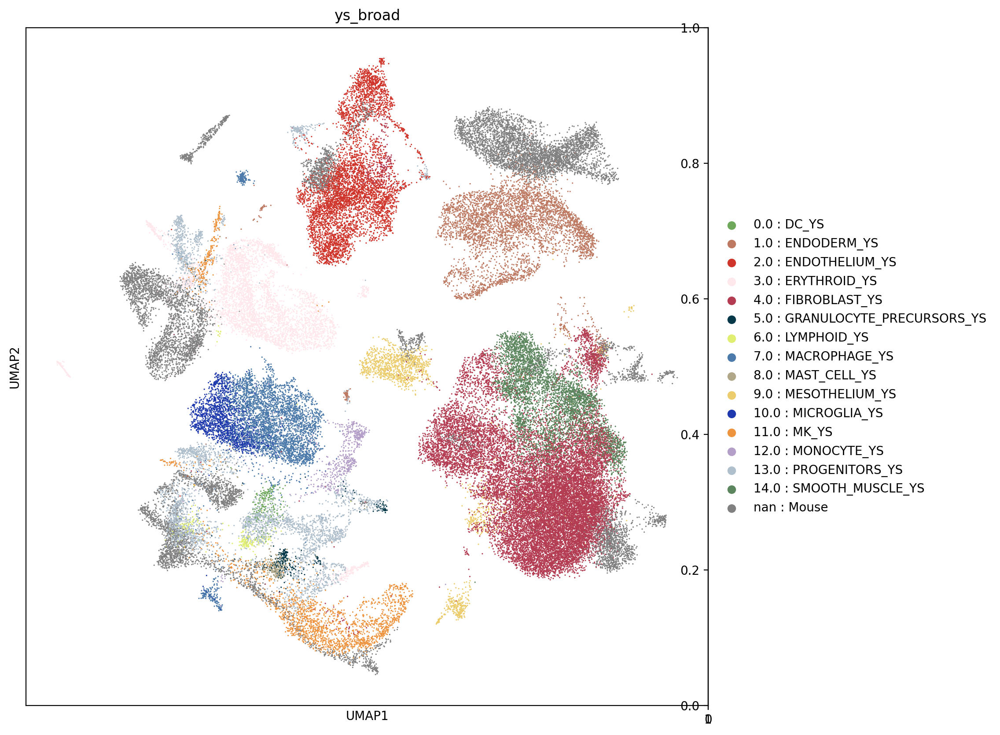

In [762]:
dic = dict(zip(cells,col))

#Create a mappable field
adata.obs['num'] = adata.obs[var]
#map to adata.obs.col to create a caterorical column
adata.obs['num'] = adata.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata.obs['num'] = adata.obs['num'].astype(str)
adata.obs[var+'_num'] = adata.obs['num'].astype(str) + " : " + adata.obs[var].astype(str)

import matplotlib.pyplot as plt
plt.rcParams['axes.facecolor'] = 'white'

import matplotlib
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.umap(adata[adata.obs["species"].isin([plot_tissue])], color = (var+'_num') ,ax=ax1,size=5,show=False,title="", palette= col_pal) #title=i
p4 = sc.pl.umap(adata[~adata.obs["species"].isin([plot_tissue])], color = (var+'_num') ,ax=ax1,size=5,show=False,title="", palette= ["#808080"]) #title=i
p3 = sc.pl.umap(adata[adata.obs["species"].isin([plot_tissue])], color = "num",legend_loc=None,size=2,legend_fontsize='small',ax=ax1,show=False,title="ys_broad", palette= col_pal) #title=i

fig.savefig('./'+var+"_"+plot_tissue+"_no_num.pdf",bbox_inches='tight')

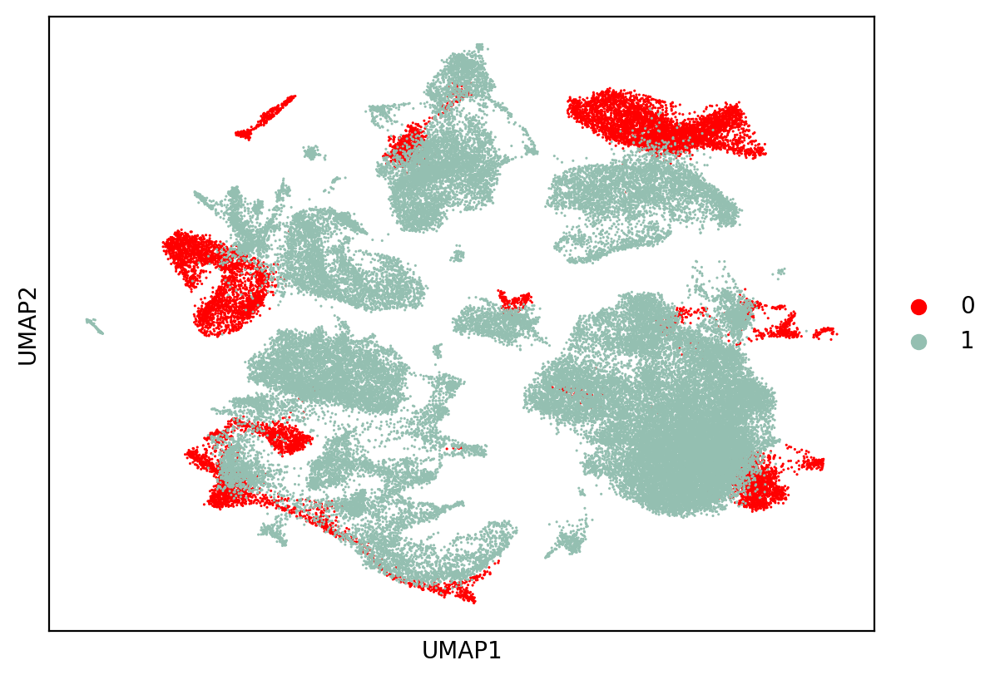

In [795]:
sc.pl.umap(adata, color = 'batch' ,size = 5,show=True,title="", palette= ['#ff0000',    '#94BFB1'], save= 'human_mouse_batch.pdf')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch_num' as categorical


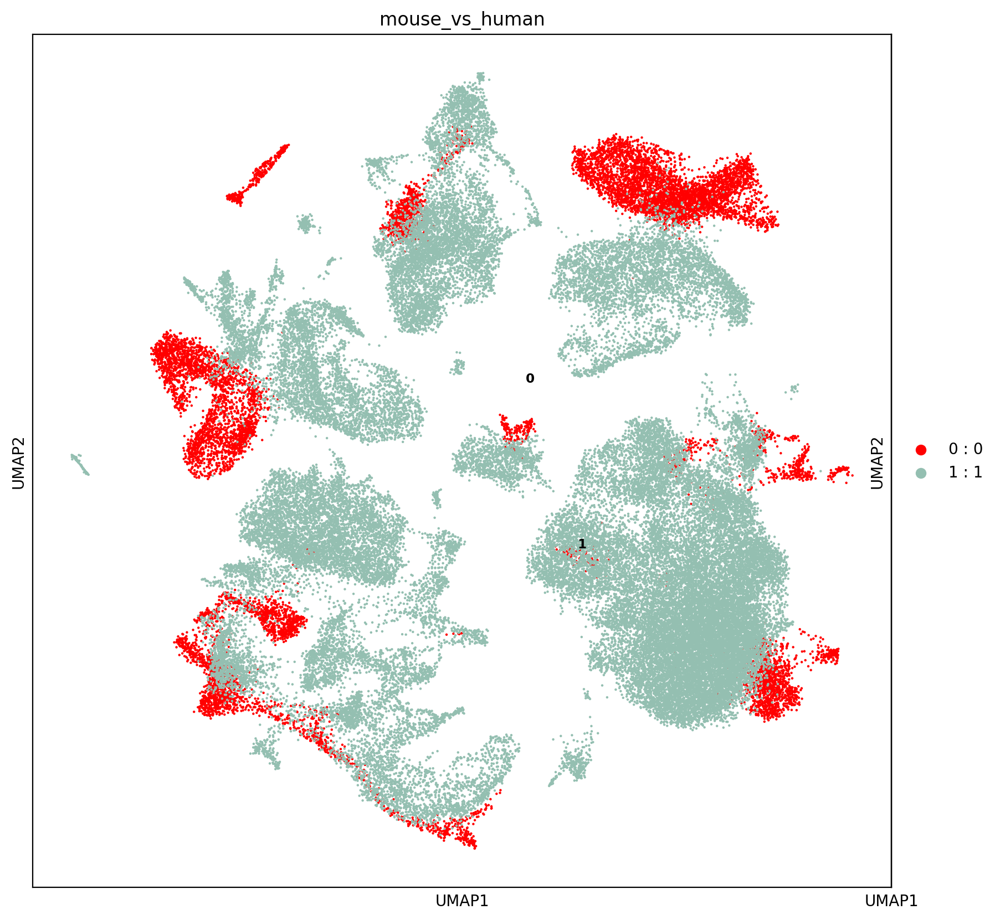

In [793]:
var = "batch"
#Create color dictionary
cells = list(adata.obs[var].unique())
col = list(range(0,len(adata.obs[var].unique())))
dic = dict(zip(cells,col))

#Create a mappable field
adata.obs['num'] = adata.obs[var]
#map to adata.obs.col to create a caterorical column
adata.obs['num'] = adata.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata.obs['num'] = adata.obs['num'].astype(str)
adata.obs[var+'_num'] = adata.obs['num'].astype(str) + " : " + adata.obs[var].astype(str)

col_pal = ['#ff0000',    '#94BFB1',    '#B49EC8',    '#E0EE70',    '#EE943E',    '#4C7BAB',    '#E78AB8',    '#AFBFCC',    '#FF993F',    "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",    "#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",    "#5A0007", "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF"]

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.umap(adata, color = (var+'_num') ,ax=ax2,show=False,title="", palette= col_pal) #title=i
p3 = sc.pl.umap(adata, color = "num",legend_loc="on data",size=10,legend_fontsize='small',ax=ax1,show=False,title="mouse_vs_human", palette= col_pal) #title=i

fig.savefig('./'+var+"_species_num.pdf",bbox_inches='tight')

 # Create probability plot for only Haem lineages

In [191]:
# Keep only comparisons
#keep = ['predicted', 'orig_labels', 'Early_Erythroid_ys', 'Erythroid_ys',
#       'HSPC_1_ys', 'HSPC_2_ys', 'MEMP_ys',
#       'MK_ys', 'MOP_ys', 'Macrophage_ys', 'Mast_cell_ys', 
#       'Microglia_ys', 'Monocyte_Macrophage_ys', 'Monocyte_ys',]
#pred_out = pred_out[keep]

# Keep only celltypes in blood progen and erythroid lineages
pred_out = pred_out[pred_out.index.isin(adata_ms_diff.obs.index)]

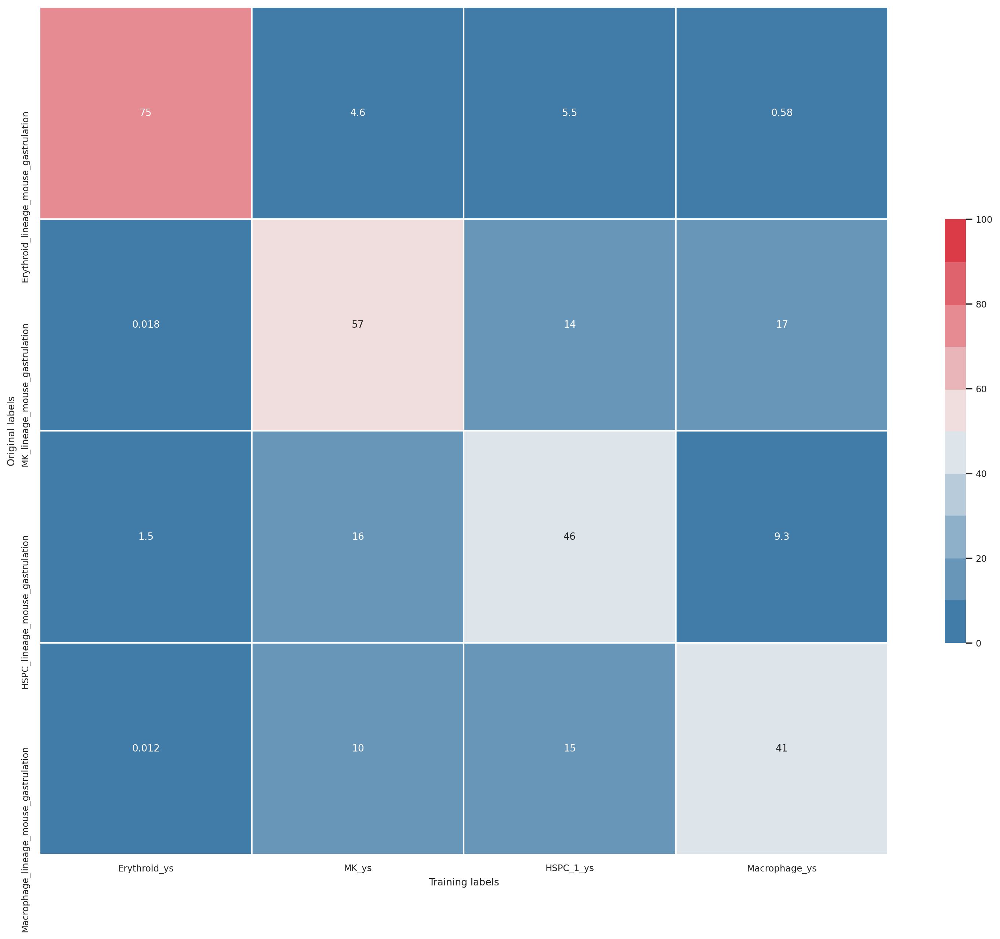

In [192]:
trim = 20

model_mean_probs = pred_out.loc[:, pred_out.columns != 'orig_labels'].groupby('predicted').mean()
model_mean_probs = model_mean_probs*100
model_mean_probs = model_mean_probs.dropna(axis=0, how='any', thresh=None, subset=None, inplace=False)
crs_tbl = model_mean_probs.copy()
# Keep only predictions with probs >20
crs_tbl = crs_tbl[crs_tbl.columns[crs_tbl.max() > trim]]

# Keep only predicted labels with probs >20
crs_tbl = crs_tbl[crs_tbl.max(axis=1) > trim]

# Sort df columns by rows

#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.index), axis=1,ascending=False)
#crs_tbl = crs_tbl.sort_values(by =list(crs_tbl.columns), axis=0,ascending=False)

index_order = list(crs_tbl.max(axis=1).sort_values(ascending=False).index)
col_order = list(crs_tbl.max(axis=0).sort_values(ascending=False).index)
crs_tbl = crs_tbl.loc[index_order]
crs_tbl = crs_tbl[col_order]


# Plot_df_heatmap(crs_tbl, cmap='coolwarm', rotation=90, vmin=20, vmax=70)
pal = sns.diverging_palette(240, 10, n=10)
plt.figure(figsize=(20,15))
sns.set(font_scale=0.8)
g = sns.heatmap(crs_tbl, cmap=pal,  annot=True,vmin=0, vmax=100, linewidths=1, center=50, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("Original labels")
plt.xlabel("Training labels")
plt.savefig("./lr_outs/lr_plot_simple_haem_only" , dpi=200)

# Plot Trajectoreis

In [562]:
#adata = sc.read('./full_combined_ys_fliv_mouse_scaled_seperately_251021.h5ad')
adata = sc.read('./adata_hu_diff.h5ad')

In [563]:
#adata = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/A4_V6_YS_integrated_data_singlets_with_raw_counts_for_MS_plotting_20210914_with_obsp_pr.h5ad')

In [564]:
#adata_hu_diff = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/FDG_FIG2/YS_Heam_trajectory_with_HE_290921.h5ad')

In [565]:
adata.obs['cell.labels'] = adata.obs['cell.labels'].astype(str)
adata.obs['corr_concat'] = adata.obs['cell.labels']+'_ys'

In [566]:
adata.obs['corr_concat']

Cell_dat_Yolksac_Cell_dat_Yolksac_AAACCTGCACCTATCC_1          MEMP_ys
Cell_dat_Yolksac_Cell_dat_Yolksac_AAACCTGCACTTAAGC_1        HSPC_1_ys
Cell_dat_Yolksac_Cell_dat_Yolksac_AAACGGGTCCTGTAGA_1     Erythroid_ys
Cell_dat_Yolksac_Cell_dat_Yolksac_AAACGGGTCTCGAGTA_1            MK_ys
Cell_dat_Yolksac_Cell_dat_Yolksac_AAAGATGGTAGCAAAT_1     Erythroid_ys
                                                            ...      
F80_Yolksac_Hep_FCAImmP8096696_TTAGGACCAGGGAGAG         Macrophage_ys
F80_Yolksac_Hep_FCAImmP8096696_TTAGGACTCGACGGAA          Erythroid_ys
F80_Yolksac_Hep_FCAImmP8096696_TTATGCTGTGGGTCAA          Erythroid_ys
F80_Yolksac_Hep_FCAImmP8096696_TTGCCGTGTAAAGGAG          Erythroid_ys
F80_Yolksac_Hep_FCAImmP8096696_TTGCGTCCACTTGGAT                 MK_ys
Name: corr_concat, Length: 15740, dtype: object

In [567]:
hu_keep = [
 'MEMP_ys',
 'HSPC_1_ys',
 'Erythroid_ys',
 'MK_ys',
 'Early_Erythroid_ys',
 'Macrophage_ys',
 'HSPC_2_ys',
 'MOP_ys',
 'CMP_ys',
 'Monocyte_ys',
 'Microglia_ys',
 'Promonocyte_ys',
 'Pre_Macrophage_ys',
 'Monocyte_Macrophage_ys']

In [568]:
adata_hu_diff= adata[adata.obs['corr_concat'].isin(hu_keep)]
adata_hu_diff

View of AnnData object with n_obs × n_vars = 15740 × 1452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'celltype', 'species', 'species_donor', 'n_counts', 'restricted_celltype', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'cell_cycle_score', 'cat_index', 'batch', 'leiden', 'num', 'corr_concat_num', 'keep'
    var: 'HGNC-0', 'ENSDB-0', 'mouse_human_homologs-0', 'DB Class Key_homogene_db-0', 'Common Organism Name_homogene_db-0', 'NCBI Taxon ID_homogene_db-0', 'Symbol_homogene_db-0', 'EntrezGene ID_homogene_db-0', 'Mouse MGI ID_homogene_db-0', 'HGNC ID_homogene_db-0', 'OMIM Gene ID_homogene_db-0', 'Genetic Location_homogene_db-0', 'Genomic Coordinates (mouse: , human: )_homogene_db-0', 'Nucleotide RefSeq IDs_homogene_db-0', 'Protein RefSeq IDs_homogene_db-0', 'SWISS_PROT IDs_homogene_db-0', 'n_cells-0', 'n_cells-1', 'mt-1', 'total_counts-1', 'highly_variable

In [ ]:
# Grab cells to keep

import pandas as pd
import scanpy as sc

new_annotations = pd.read_csv('Issac-cell-labels-UBI62GHL.csv',
                         comment='#',
                         dtype='category',
                         index_col=0)
adata_hu_diff.obs = adata_hu_diff.obs.join(new_annotations)

In [220]:
adata_hu_diff = adata_hu_diff[adata_hu_diff.obs['keep'].isin(['true'])]

In [570]:
#SNN
#sc.pp.neighbors(adata_hu_diff, n_neighbors=3, n_pcs=40,copy=False)
#sc.tl.draw_graph(adata_hu_diff, layout='fa')

AEC_ys	#f97864
CMP_ys	#67839c
DC2_ys	#6ea85b
DC_precursor_ys	#a9e9b9
Early_Erythroid_ys	#ea9bc2
Endoderm_ys	#bd7961
Eo_Baso_Mast_precursor_ys	#814f75
Eo_Basophil_ys	#634f81
Erythroid_ys	#FFE8EC
Fibroblast_ys	#b43c52
HE_ys	#eb2a0a
HSPC_1_ys	#afbfcc
HSPC_2_ys	#F0DB00
ILC_precursor_ys	#F25602
Immature_EC_ys	#edad9d
LMPP_ys	#7a2839
Lymphoid_progenitor_ys	#FFFF99
MEMP_ys	#b87056
MK_ys	#ee943f
MOP_ys	#AB0890
Macrophage_ys	#4c7bab
Mast_cell_ys	#b0a789
Mesothelium_ys	#eccd6e
Microglia_ys	#1e38ad
Monocyte_ys	#b49fc8
Monocyte_Macrophage_ys	#3e007c
NK_ys	#9b9b00
Neutrophil_precursor_ys	#05394a
Pre_Macrophage_ys	#66b1d2
Prolif_AEC_ys	#f64528
Prolif_Sinusoidal_EC_ys	#D0352B
Promonocyte_ys	#e7d4e7
Sinusoidal_EC_ys	#E1736C
Smooth_Muscle_ys	#5c865e
VWF_EC_ys	#752017

In [571]:
col_selector = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/resources/human_mouse_pal.csv')
col_selector = dict(zip(col_selector.iloc[:,0],col_selector.iloc[:,1]))

In [574]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis',dpi_save=500, frameon=True, vector_friendly=True)
plt.rcParams['figure.figsize'] = [10, 10]

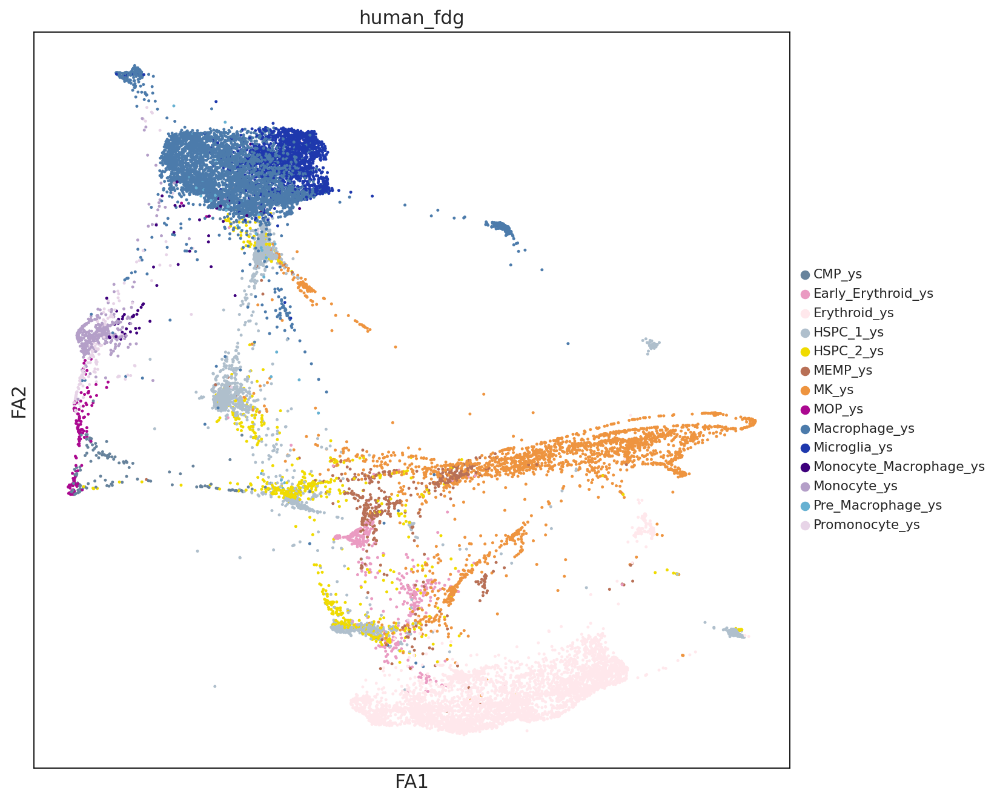

In [576]:
sc.pl.draw_graph(adata_hu_diff, color = "corr_concat",size=20,legend_fontsize='x-small',title="human_fdg", palette= col_selector,save = 'human_fdg_haem.pdf')

In [ ]:
var = "corr_concat"
#Create color dictionary
cells = hu_keep   #list(adata.obs[var].unique())
col = list(range(0,len(adata_hu_diff.obs[var].unique())))
dic = dict(zip(cells,col))

#Create a mappable field
adata_hu_diff.obs['num'] = adata_hu_diff.obs[var]
#map to adata.obs.col to create a caterorical column
adata_hu_diff.obs['num'] = adata_hu_diff.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata_hu_diff.obs['num'] = adata_hu_diff.obs['num'].astype(str)
adata_hu_diff.obs[var+'_num'] = adata_hu_diff.obs['num'].astype(str) + " : " +adata_hu_diff.obs[var].astype(str)

col_pal = [
    
    
]

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.draw_graph(adata_hu_diff, color = (var+'_num') ,ax=ax2,show=False,title="", palette= col_selector) #title=i
p3 = sc.pl.draw_graph(adata_hu_diff, color = "num",legend_loc="on data",size=20,legend_fontsize='x-small',ax=ax1,show=False,title="Myeloid_broad", palette= col_selector) #title=i

#ax1.margins(x=-0.3, y=-0.4) 
#ax1.text( (x=-0.4, y=-0.4, rotation=90)

fig.savefig('./'+var+"_num.pdf",bbox_inches='tight', dpi = 700)

In [ ]:
adata_hu_diff.write('adata_hu_diff.h5ad')

# Plot mouse traj heam
 # Create psuedotime plots for matching HSPC trajectories

In [989]:
adata.obs

,barcode,sample,stage,sequencing.batch,celltype,species,species_donor,n_counts,restricted_celltype,n_genes,...,sort.ids,fetal.ids,component,broad_cell.labels,sequencing.type,orig.dataset,cell_cycle_score,cat_index,batch,leiden
cell_55,AGCTTTACGAATCC,1,E6.5,1,ExE endoderm,Mouse,Mouse_1,9015.0,ExE endoderm_2,2471,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,15
cell_56,AGGAATGATTTGGG,1,E6.5,1,ExE endoderm,Mouse,Mouse_1,9860.0,ExE endoderm_2,2626,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,5
cell_58,AGGCAGGAGGTAGG,1,E6.5,1,ExE endoderm,Mouse,Mouse_1,5481.0,ExE endoderm_4,1876,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,22
cell_64,AGTCCAGAGAAACA,1,E6.5,1,Visceral endoderm,Mouse,Mouse_1,11282.0,Visceral endoderm_3,2940,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,22
cell_73,ATCGCGCTTATTCC,1,E6.5,1,ExE endoderm,Mouse,Mouse_1,6956.0,ExE endoderm_0,2426,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
F80_Yolksac_Hep_FCAImmP8096696_TTTGCGCTCGCACTCT,NaN,NaN,CS15,NaN,NaN,Human,Human_F80,5729.0,NaN,1815,...,CD45N,F80,Membrane,Fibroblast,5GEX,De_novo,0.172537,12,1,4
F80_Yolksac_Hep_FCAImmP8096696_TTTGGTTAGCTAGTCT,NaN,NaN,CS15,NaN,NaN,Human,Human_F80,9956.0,NaN,2485,...,CD45N,F80,Membrane,Mesothelium,5GEX,De_novo,0.266033,10,1,19
F80_Yolksac_Hep_FCAImmP8096696_TTTGTCAAGATGCCAG,NaN,NaN,CS15,NaN,NaN,Human,Human_F80,14958.0,NaN,3528,...,CD45N,F80,Membrane,Endothelium,5GEX,De_novo,0.449059,5,1,3
F80_Yolksac_Hep_FCAImmP8096696_TTTGTCAGTCGAACAG,NaN,NaN,CS15,NaN,NaN,Human,Human_F80,14249.0,NaN,3412,...,CD45N,F80,Membrane,Endothelium,5GEX,De_novo,0.337562,5,1,3


In [97]:
mu_keep = [
 'Blood progenitors 2_2_mouse_gastrulation',
 'Blood progenitors 2_3_mouse_gastrulation',
 'Blood progenitors 1_0_mouse_gastrulation',
 'Erythroid1_2_mouse_gastrulation',
 'Blood progenitors 1_1_mouse_gastrulation',
 'Blood progenitors 2_5_mouse_gastrulation',
 'Blood progenitors 2_1_mouse_gastrulation',
 'Blood progenitors 2_0_mouse_gastrulation',
 'Blood progenitors 1_2_mouse_gastrulation',
 'Blood progenitors 2_4_mouse_gastrulation',
 'Erythroid1_1_mouse_gastrulation',
 'Erythroid1_0_mouse_gastrulation',
 'Erythroid1_3_mouse_gastrulation',
 'Erythroid2_0_mouse_gastrulation',
 'Erythroid2_1_mouse_gastrulation',
 'Erythroid2_3_mouse_gastrulation',
 'Erythroid3_3_mouse_gastrulation',
 'Erythroid2_2_mouse_gastrulation',
 'Erythroid3_0_mouse_gastrulation',
 'Erythroid3_2_mouse_gastrulation',
 'Erythroid3_1_mouse_gastrulation',
 'Blood progenitors 1_3_mouse_gastrulation']

In [1062]:
adata_ms_diff= adata[adata.obs['corr_concat'].isin(mu_keep)]
adata_ms_diff

View of AnnData object with n_obs × n_vars = 4749 × 1452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'celltype', 'species', 'species_donor', 'n_counts', 'restricted_celltype', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'cell_cycle_score', 'cat_index', 'batch', 'leiden'
    var: 'HGNC-0', 'ENSDB-0', 'mouse_human_homologs-0', 'DB Class Key_homogene_db-0', 'Common Organism Name_homogene_db-0', 'NCBI Taxon ID_homogene_db-0', 'Symbol_homogene_db-0', 'EntrezGene ID_homogene_db-0', 'Mouse MGI ID_homogene_db-0', 'HGNC ID_homogene_db-0', 'OMIM Gene ID_homogene_db-0', 'Genetic Location_homogene_db-0', 'Genomic Coordinates (mouse: , human: )_homogene_db-0', 'Nucleotide RefSeq IDs_homogene_db-0', 'Protein RefSeq IDs_homogene_db-0', 'SWISS_PROT IDs_homogene_db-0', 'n_cells-0', 'n_cells-1', 'mt-1', 'total_counts-1', 'highly_variable-1', 'intersect-1', 'means-1', 'dis

In [ ]:
adata_ms_diff = sc.read('')

In [1063]:
sc.settings.set_figure_params(dpi=80, color_map='viridis')
plt.rcParams['figure.figsize'] = [15, 15]

In [1064]:
sc.tl.draw_graph(adata_ms_diff, layout='fa')

drawing single-cell graph using layout 'fa'


Trying to set attribute `.uns` of view, copying.


    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:34)


In [1065]:
adata_ms_diff

AnnData object with n_obs × n_vars = 4749 × 1452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'celltype', 'species', 'species_donor', 'n_counts', 'restricted_celltype', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'cell_cycle_score', 'cat_index', 'batch', 'leiden'
    var: 'HGNC-0', 'ENSDB-0', 'mouse_human_homologs-0', 'DB Class Key_homogene_db-0', 'Common Organism Name_homogene_db-0', 'NCBI Taxon ID_homogene_db-0', 'Symbol_homogene_db-0', 'EntrezGene ID_homogene_db-0', 'Mouse MGI ID_homogene_db-0', 'HGNC ID_homogene_db-0', 'OMIM Gene ID_homogene_db-0', 'Genetic Location_homogene_db-0', 'Genomic Coordinates (mouse: , human: )_homogene_db-0', 'Nucleotide RefSeq IDs_homogene_db-0', 'Protein RefSeq IDs_homogene_db-0', 'SWISS_PROT IDs_homogene_db-0', 'n_cells-0', 'n_cells-1', 'mt-1', 'total_counts-1', 'highly_variable-1', 'intersect-1', 'means-1', 'dispersions

In [1066]:
sc.settings.set_figure_params(dpi=200, color_map='viridis')
plt.rcParams['figure.figsize'] = [15, 15]
plt.rcParams['axes.xmargin'] = 0.4
plt.rcParams['axes.ymargin'] = 0.4

In [1067]:
mu_keep = sorted(mu_keep)

In [1068]:
mu_keep

['Blood progenitors 1_0_mouse_gastrulation',
 'Blood progenitors 1_1_mouse_gastrulation',
 'Blood progenitors 1_2_mouse_gastrulation',
 'Blood progenitors 1_3_mouse_gastrulation',
 'Blood progenitors 2_0_mouse_gastrulation',
 'Blood progenitors 2_1_mouse_gastrulation',
 'Blood progenitors 2_2_mouse_gastrulation',
 'Blood progenitors 2_3_mouse_gastrulation',
 'Blood progenitors 2_4_mouse_gastrulation',
 'Blood progenitors 2_5_mouse_gastrulation',
 'Erythroid1_0_mouse_gastrulation',
 'Erythroid1_1_mouse_gastrulation',
 'Erythroid1_2_mouse_gastrulation',
 'Erythroid1_3_mouse_gastrulation',
 'Erythroid2_0_mouse_gastrulation',
 'Erythroid2_1_mouse_gastrulation',
 'Erythroid2_2_mouse_gastrulation',
 'Erythroid2_3_mouse_gastrulation',
 'Erythroid3_0_mouse_gastrulation',
 'Erythroid3_1_mouse_gastrulation',
 'Erythroid3_2_mouse_gastrulation',
 'Erythroid3_3_mouse_gastrulation']

In [1069]:
adata_ms_diff.obs['predicted_human_mouse'] =  pred_out['predicted']
adata_ms_diff.obs['predicted_human_mouse']
mu_keep = sorted(list(pred_out['predicted'].unique()))

In [1070]:
dic

{'0': 0,
 '6': 1,
 '12': 2,
 '7': 3,
 '8': 4,
 '2': 5,
 '5': 6,
 '10': 7,
 '11': 8,
 '3': 9,
 '1': 10}

In [260]:
adata_ms_diff

AnnData object with n_obs × n_vars = 4717 × 1452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'celltype', 'species', 'species_donor', 'n_counts', 'restricted_celltype', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'cell_cycle_score', 'cat_index', 'batch', 'leiden', 'predicted_human_mouse', 'num', 'leiden_num', 'prediction', 'predicted', 'predicted_num', 'predicted_human_mouse_num'
    var: 'HGNC-0', 'ENSDB-0', 'mouse_human_homologs-0', 'DB Class Key_homogene_db-0', 'Common Organism Name_homogene_db-0', 'NCBI Taxon ID_homogene_db-0', 'Symbol_homogene_db-0', 'EntrezGene ID_homogene_db-0', 'Mouse MGI ID_homogene_db-0', 'HGNC ID_homogene_db-0', 'OMIM Gene ID_homogene_db-0', 'Genetic Location_homogene_db-0', 'Genomic Coordinates (mouse: , human: )_homogene_db-0', 'Nucleotide RefSeq IDs_homogene_db-0', 'Protein RefSeq IDs_homogene_db-0', 'SWISS_PROT IDs_homogene

In [261]:
sc.tl.leiden(adata_ms_diff)

running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [262]:
adata_ms_diff.obs

,barcode,sample,stage,sequencing.batch,celltype,species,species_donor,n_counts,restricted_celltype,n_genes,...,cat_index,batch,leiden,predicted_human_mouse,num,leiden_num,prediction,predicted,predicted_num,predicted_human_mouse_num
cell_363,AAAGATCTCTCGAA,2,E7.5,1,Blood progenitors 2,Mouse,Mouse_2,11274.0,Blood progenitors 2_2,2731,...,NaN,0,10,HSPC_1_ys,1,9 : 9,HSPC_1_ys,HSPC_1_lineage_mouse_gastrulation,1 : HSPC_1_lineage_mouse_gastrulation,4 : HSPC_1_ys
cell_382,AATCTCACTGCTTT,2,E7.5,1,Blood progenitors 2,Mouse,Mouse_2,8414.0,Blood progenitors 2_2,2608,...,NaN,0,4,Macrophage_ys,4,4 : 4,Macrophage_ys,Macrophage_lineage_mouse_gastrulation,4 : Macrophage_lineage_mouse_gastrulation,9 : Macrophage_ys
cell_385,AATGGCTGAAGATG,2,E7.5,1,Blood progenitors 2,Mouse,Mouse_2,14521.0,Blood progenitors 2_2,3110,...,NaN,0,9,HSPC_1_ys,1,0 : 0,HSPC_1_ys,HSPC_1_lineage_mouse_gastrulation,1 : HSPC_1_lineage_mouse_gastrulation,4 : HSPC_1_ys
cell_393,ACACATCTGTCAAC,2,E7.5,1,Blood progenitors 2,Mouse,Mouse_2,10735.0,Blood progenitors 2_3,2477,...,NaN,0,1,HSPC_1_ys,1,0 : 0,HSPC_1_ys,HSPC_1_lineage_mouse_gastrulation,1 : HSPC_1_lineage_mouse_gastrulation,4 : HSPC_1_ys
cell_410,ACTCCCGAGTCACA,2,E7.5,1,Blood progenitors 1,Mouse,Mouse_2,15950.0,Blood progenitors 1_0,3474,...,NaN,0,4,Macrophage_ys,4,4 : 4,Macrophage_ys,Macrophage_lineage_mouse_gastrulation,4 : Macrophage_lineage_mouse_gastrulation,9 : Macrophage_ys
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
cell_139315,TTTATCCTGTCACA,37,E8.5,3,Erythroid1,Mouse,Mouse_37,11011.0,Erythroid1_3,2669,...,NaN,0,2,Erythroid_ys,0,2 : 2,Erythroid_ys,Erythroid_lineage_mouse_gastrulation,0 : Erythroid_lineage_mouse_gastrulation,3 : Erythroid_ys
cell_139321,TTTCAGTGCGAGTT,37,E8.5,3,Erythroid3,Mouse,Mouse_37,13763.0,Erythroid3_1,2956,...,NaN,0,0,Erythroid_ys,0,1 : 1,Erythroid_ys,Erythroid_lineage_mouse_gastrulation,0 : Erythroid_lineage_mouse_gastrulation,3 : Erythroid_ys
cell_139326,TTTCGAACGGTGAG,37,E8.5,3,Erythroid3,Mouse,Mouse_37,18515.0,Erythroid3_0,3258,...,NaN,0,0,Erythroid_ys,0,1 : 1,Erythroid_ys,Erythroid_lineage_mouse_gastrulation,0 : Erythroid_lineage_mouse_gastrulation,3 : Erythroid_ys
cell_139327,TTTCGAACTAACCG,37,E8.5,3,Erythroid3,Mouse,Mouse_37,11905.0,Erythroid3_1,2725,...,NaN,0,0,Erythroid_ys,0,1 : 1,Erythroid_ys,Erythroid_lineage_mouse_gastrulation,0 : Erythroid_lineage_mouse_gastrulation,3 : Erythroid_ys


In [1086]:
keep = [
'0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '11',]
adata_ms_diff = adata_ms_diff[adata_ms_diff.obs['leiden'].isin(keep)]

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'leiden_num' as categorical
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and wil

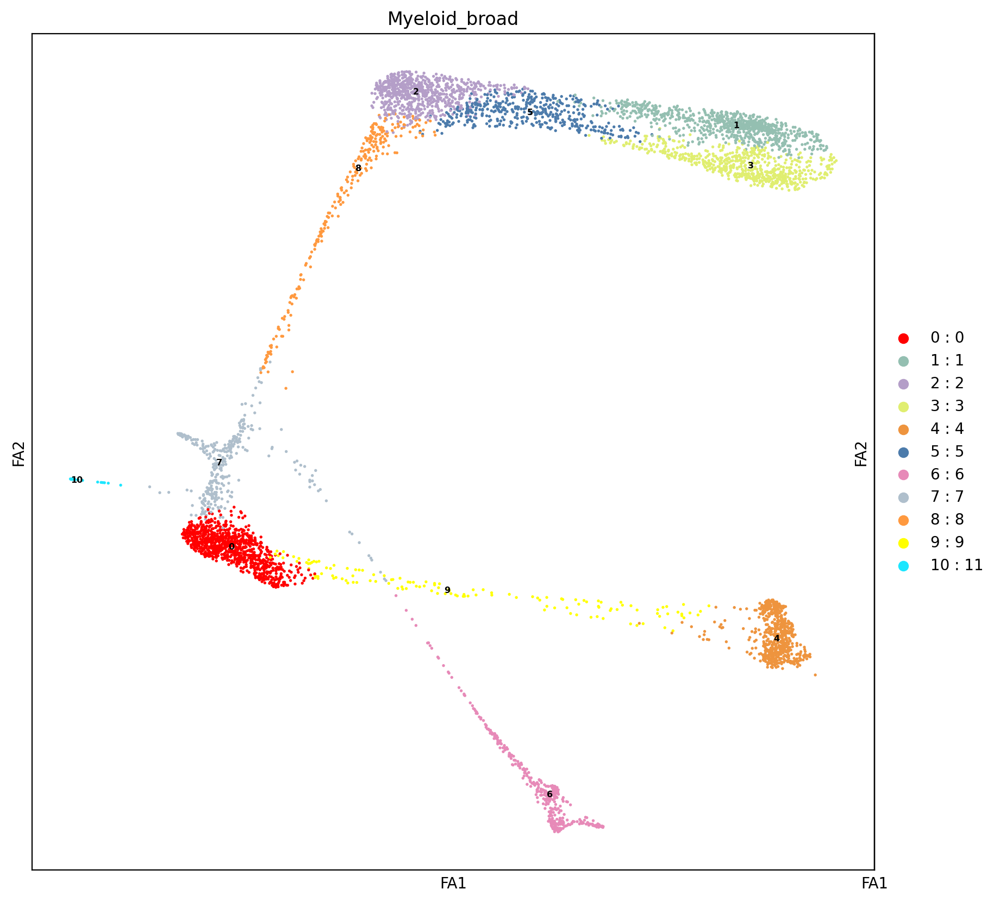

In [98]:
var = 'corr_concat'
var = 'predicted_human_mouse'
var = 'leiden'
#Create color dictionary
cells = mu_keep  #list(adata.obs[var].unique())
cells = sorted(list(adata_ms_diff.obs[var].astype(int).unique()))
cells = [str(s) for s in cells]
col = list(range(0,len(adata_ms_diff.obs[var].unique())))
dic = dict(zip(cells,col))

#Create a mappable field
adata_ms_diff.obs['num'] = adata_ms_diff.obs[var]
#map to adata.obs.col to create a caterorical column
adata_ms_diff.obs['num'] = adata_ms_diff.obs['num'].map(dic)

##Map to a pallete to use with umap
#cells_list = pd.DataFrame(adata.obs["cell.labels"].cat.categories)
#cells_list['col'] = cells_list[0].map(dic)
#col_pal = list(cells_list['col'])
adata_ms_diff.obs['num'] =adata_ms_diff.obs['num'].astype(str)
adata_ms_diff.obs[var+'_num'] = adata_ms_diff.obs['num'].astype(str) + " : " + adata_ms_diff.obs[var].astype(str)

col_pal = ['#ff0000',    '#94BFB1',    '#B49EC8',    '#E0EE70',    '#EE943E',    '#4C7BAB',    '#E78AB8',    '#AFBFCC',    '#FF993F',    "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",    "#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",    "#5A0007", "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF"]

import matplotlib
matplotlib.rcdefaults() #Reset matplot lb deafults as seaborne tends to mess with this
fig, (ax1, ax2,) = plt.subplots(1,2, figsize=(10,10), gridspec_kw={'wspace':0,'width_ratios': [1,0]})
p2 = sc.pl.draw_graph(adata_ms_diff, color = (var+'_num') ,ax=ax2,show=False,title="", palette= col_pal) #title=i
p3 = sc.pl.draw_graph(adata_ms_diff, color = "num",legend_loc="on data",size=15,legend_fontsize='xx-small',ax=ax1,show=False,title="Myeloid_broad", palette= col_pal) #title=i
fig.savefig('./'+var+"_mouse_num.pdf",bbox_inches='tight')

In [1116]:
adata_ms_diff.write('./adata_ms_diff.h5ad')

In [613]:
adata_ms_diff = sc.read('./adata_ms_diff.h5ad')

# Are there monocytes in the mouse atlas?  or extended mouse atlas?

In [97]:
adata_ms_diff = sc.read('./adata_ms_diff.h5ad')

In [134]:
#adata = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/mouse_ys_enst.h5ad')
adata = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/mouse_data_built_261021_raw_enst.h5ad')

In [5]:
adata = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/extended_mouse_atlas/EmbryoData2020/embryo_mnn_bbknn_shiny.h5ad')

/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/compat/__init__.py:180: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/compat/__init__.py:180: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [135]:
adata.var['HGNC'] = adata.var['HGNC'].astype(str)
adata.var = adata.var.set_index('HGNC')
adata.var_names_make_unique()
adata

AnnData object with n_obs × n_vars = 139331 × 29452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'theiler', 'doub.density', 'doublet', 'cluster', 'cluster.sub', 'cluster.stage', 'cluster.theiler', 'stripped', 'celltype', 'colour', 'umapX', 'umapY', 'haem_gephiX', 'haem_gephiY', 'haem_subclust', 'endo_gephiX', 'endo_gephiY', 'endo_trajectoryName', 'endo_trajectoryDPT', 'endo_gutX', 'endo_gutY', 'endo_gutDPT', 'endo_gutCluster'
    var: 'mouse_human_homologs', 'DB Class Key_homogene_db', 'Common Organism Name_homogene_db', 'NCBI Taxon ID_homogene_db', 'Symbol_homogene_db', 'EntrezGene ID_homogene_db', 'Mouse MGI ID_homogene_db', 'HGNC ID_homogene_db', 'OMIM Gene ID_homogene_db', 'Genetic Location_homogene_db', 'Genomic Coordinates (mouse: , human: )_homogene_db', 'Nucleotide RefSeq IDs_homogene_db', 'Protein RefSeq IDs_homogene_db', 'SWISS_PROT IDs_homogene_db', 'ets'

In [136]:
adata.var[adata.var.index.isin(['Adgre1'])]

,mouse_human_homologs,DB Class Key_homogene_db,Common Organism Name_homogene_db,NCBI Taxon ID_homogene_db,Symbol_homogene_db,EntrezGene ID_homogene_db,Mouse MGI ID_homogene_db,HGNC ID_homogene_db,OMIM Gene ID_homogene_db,Genetic Location_homogene_db,"Genomic Coordinates (mouse: , human: )_homogene_db",Nucleotide RefSeq IDs_homogene_db,Protein RefSeq IDs_homogene_db,SWISS_PROT IDs_homogene_db,ets
HGNC,,,,,,,,,,,,,,,
Adgre1,ENSMUSG00000004730,39512472.0,"mouse, laboratory",10090.0,Adgre1,13733.0,MGI:106912,NaN,NaN,Chr17 29.8 cM,Chr17:57665691-57790527(+),"XM_036160297,NM_001355722,NM_010130,NM_0013557...","XP_036016190,XP_006523665,NP_001342652,NP_0013...",Q61549,ENSMUST00000004850.8


In [115]:
obs = adata_ms_diff.obs.copy()

In [116]:
adata_ms_diff = adata[adata.obs.index.isin(obs.index)]
adata_ms_diff.obs = obs

In [7]:
## Markers from paper
markers = {
"HSC/MPP":["Ifitm1","Mecom","Hoxa9","Mycn","Hlf",],
"CMP":	["Mpo","Spi1","Cd34","Prtn3","Ccl9"],
"CLP":	["Ccr9","Cd7","Notch1","Satb1","Cd79a"],
"MegE":["Gata1","Epor","Klf1","Car1"],
"Erythroid cell":["Hbb-bs","Hbb-bt","Hba-a2","Ermap","Alad"],
"Megakaryocyte":["Vwf","Itga2b","Itgb3","Plek","Pf4"],
"Neutrophil":["Gstm1","Elane","Ctsg","Fcnb"],
"Endothelial cell":["Lyve1","Kdr","Sox17","Pecam1","Esam"],
"Stromal cell":["Pdgfra","Alcam","Col1a2","Mmp2", "Ncam1"],
"Hepatoblast":["Afp","Alb","Ttr","Igfbp1","Hnf4a"],
"B cell":["Blnk","Pax5","Cd19","Ebf1","Vpreb1"],
"Basophil":["Cpa3","Rnase12","Il6","Stx3","Alox15"],
'mouse_mono':['Cd14','Ccr2','Itgam','Fcgr3','Pecam1','Cd44','Sell','Plac8','Cx3cr1','Csf1r','Adgre1','Ly6g','Ly6c1'],
"Kupffer_cells":["Adgre1","Fcgr1","C1qa","Csf1r"],
"more_mac_mono_markers":["Cd68","Ly86","Fcgr1","Csf1r","Hmox1"],
}

In [123]:
list(adata_ms_diff.obs['predicted'].unique())

['HSPC_1_lineage_mouse_gastrulation',
 'Macrophage_lineage_mouse_gastrulation',
 'MK_lineage_mouse_gastrulation',
 'Erythroid_lineage_mouse_gastrulation',
 'CMP_lineage_mouse_gastrulation']

In [125]:
order = ['HSPC_1_lineage_mouse_gastrulation',
 'MK_lineage_mouse_gastrulation',
 'Erythroid_lineage_mouse_gastrulation',
 'CMP_lineage_mouse_gastrulation',
 'Macrophage_lineage_mouse_gastrulation',]

In [128]:
adata_ms_diff.var[adata_ms_diff.var.index.isin(['Adgre1'])]

,mouse_human_homologs,DB Class Key_homogene_db,Common Organism Name_homogene_db,NCBI Taxon ID_homogene_db,Symbol_homogene_db,EntrezGene ID_homogene_db,Mouse MGI ID_homogene_db,HGNC ID_homogene_db,OMIM Gene ID_homogene_db,Genetic Location_homogene_db,"Genomic Coordinates (mouse: , human: )_homogene_db",Nucleotide RefSeq IDs_homogene_db,Protein RefSeq IDs_homogene_db,SWISS_PROT IDs_homogene_db,ets
HGNC,,,,,,,,,,,,,,,
Adgre1,ENSMUSG00000004730,39512472.0,"mouse, laboratory",10090.0,Adgre1,13733.0,MGI:106912,NaN,NaN,Chr17 29.8 cM,Chr17:57665691-57790527(+),"XM_036160297,NM_001355722,NM_010130,NM_0013557...","XP_036016190,XP_006523665,NP_001342652,NP_0013...",Q61549,ENSMUST00000004850.8


# Just gastrula YS

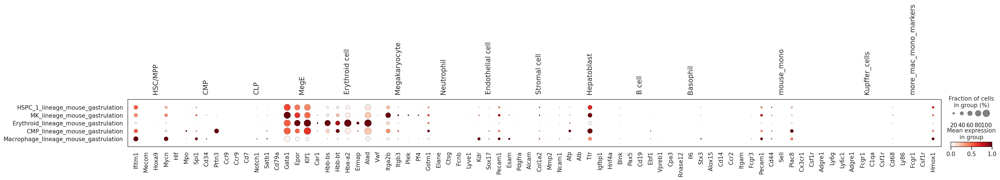

In [129]:
data_temp = adata_ms_diff
markers = markers
spot_var = 'predicted'
(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False, color_map='Reds', show = True,standard_scale='var',categories_order = order))

In [133]:
adata

AnnData object with n_obs × n_vars = 139331 × 29452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'theiler', 'doub.density', 'doublet', 'cluster', 'cluster.sub', 'cluster.stage', 'cluster.theiler', 'stripped', 'celltype', 'colour', 'umapX', 'umapY', 'haem_gephiX', 'haem_gephiY', 'haem_subclust', 'endo_gephiX', 'endo_gephiY', 'endo_trajectoryName', 'endo_trajectoryDPT', 'endo_gutX', 'endo_gutY', 'endo_gutDPT', 'endo_gutCluster'
    var: 'mouse_human_homologs', 'DB Class Key_homogene_db', 'Common Organism Name_homogene_db', 'NCBI Taxon ID_homogene_db', 'Symbol_homogene_db', 'EntrezGene ID_homogene_db', 'Mouse MGI ID_homogene_db', 'HGNC ID_homogene_db', 'OMIM Gene ID_homogene_db', 'Genetic Location_homogene_db', 'Genomic Coordinates (mouse: , human: )_homogene_db', 'Nucleotide RefSeq IDs_homogene_db', 'Protein RefSeq IDs_homogene_db', 'SWISS_PROT IDs_homogene_db', 'ets'

# With full gatrula data

In [13]:
adata.obs['lr_batch']

cell
cell_1          1
cell_2          1
cell_3          1
cell_4          1
cell_5          1
               ..
cell_139327    37
cell_139328    37
cell_139329    37
cell_139330    37
cell_139331    37
Name: lr_batch, Length: 139331, dtype: int64

In [ ]:
# Only consider intersecting genes for normalisation etc
#remove_genes = pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/data_integration_070721/keep_intersecting_genes.csv',index_col=0)
#keep_genes = list(remove_genes['0'])
#adata = adata[:, adata.var.index.isin(keep_genes)]
# sc.pp.normalize_total(adata, target_sum=1e4)
# sc.pp.log1p(adata)
# #sc.pp.scale(adata, max_value=10)
# sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

#common_cat = 'leiden'
batch_correction = "Harmony" # Will accept Harmony, BBKNN or False as options
batch = ['sample'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
adata.obs['lr_batch'] = adata.obs[batch]
#batch = ['tissue'] # Will accept any batch categorical. Comma space a batch categorical for each dataset. Position 1 is for data1, position 2 is for data2
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
if(batch_correction == "Harmony"):
    print("Commencing harmony")
    # Create hm subset
    adata_hm = adata[:]
    # Set harmony variables
    data_mat = np.array(adata_hm.obsm["X_pca"])
    meta_data = adata_hm.obs
    vars_use = batch
    # Run Harmony
    ho = hm.run_harmony(data_mat, meta_data, vars_use,theta = 5)
    res = (pd.DataFrame(ho.Z_corr)).T
    res.columns = ['X{}'.format(i + 1) for i in range(res.shape[1])]
    # Insert coordinates back into object
    adata_hm.obsm["X_pca_back"]= adata_hm.obsm["X_pca"][:]
    adata_hm.obsm["X_pca"] = np.array(res)
    # Run neighbours
    sc.pp.neighbors(adata_hm, n_neighbors=15, n_pcs=50)
    #sc.tl.umap(adata_hm)
    adata = adata_hm[:]
    del adata_hm
#sc.tl.draw_graph(adata, layout='fa')
#sc.tl.umap(adata)

normalizing counts per cell
    finished (0:00:06)
extracting highly variable genes


In [12]:
adata

AnnData object with n_obs × n_vars = 139331 × 29452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'theiler', 'doub.density', 'doublet', 'cluster', 'cluster.sub', 'cluster.stage', 'cluster.theiler', 'stripped', 'celltype', 'colour', 'umapX', 'umapY', 'haem_gephiX', 'haem_gephiY', 'haem_subclust', 'endo_gephiX', 'endo_gephiY', 'endo_trajectoryName', 'endo_trajectoryDPT', 'endo_gutX', 'endo_gutY', 'endo_gutDPT', 'endo_gutCluster', 'lr_batch', 'leiden'
    var: 'mouse_human_homologs', 'DB Class Key_homogene_db', 'Common Organism Name_homogene_db', 'NCBI Taxon ID_homogene_db', 'Symbol_homogene_db', 'EntrezGene ID_homogene_db', 'Mouse MGI ID_homogene_db', 'HGNC ID_homogene_db', 'OMIM Gene ID_homogene_db', 'Genetic Location_homogene_db', 'Genomic Coordinates (mouse: , human: )_homogene_db', 'Nucleotide RefSeq IDs_homogene_db', 'Protein RefSeq IDs_homogene_db', 'SWISS_PROT IDs_homogene_db', 'ets', 'mean', 'std', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns

In [18]:
res = 0.001
key_add = 'leiden'
sc.tl.leiden(adata, resolution= res,key_added= key_add, random_state=26, n_iterations=-1)

# overall

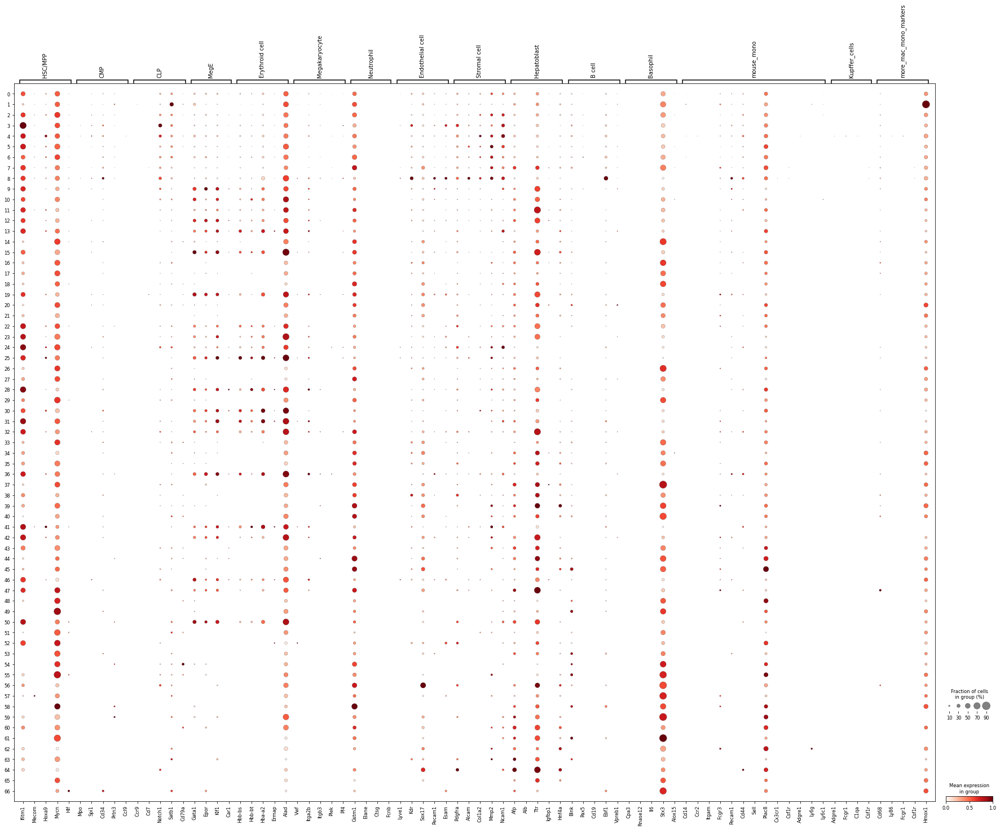

In [19]:
data_temp = adata
markers = markers
spot_var = 'leiden'
(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False, color_map='Reds', show = True,standard_scale='var',save = 'overall_extended2_mouse_atlas_monocyte_markers'))

In [36]:
adata.obs['cluster'] = adata.obs['cluster'].astype(str)
test = adata[~adata.obs['cluster'].isin(['nan'])]

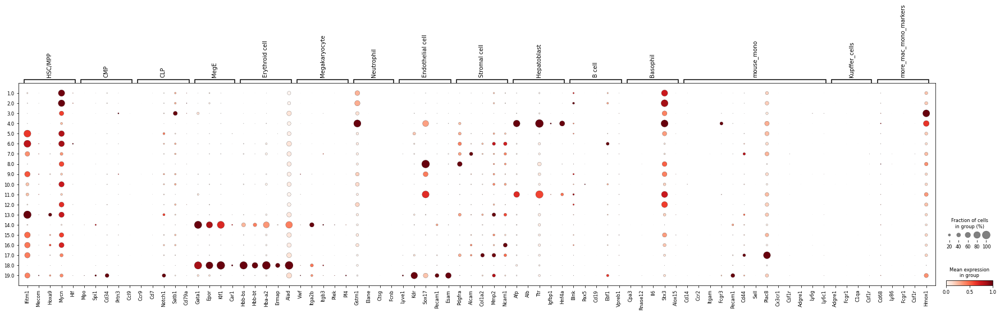

In [38]:
data_temp = test
markers = markers
spot_var = 'cluster'
(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False, color_map='Reds', show = True,standard_scale='var',save = 'overall_extended3_mouse_atlas_monocyte_markers'))

# YS_only

In [41]:
adata.obs

,barcode,sample,stage,sequencing.batch,theiler,doub.density,doublet,cluster,cluster.sub,cluster.stage,...,endo_gephiX,endo_gephiY,endo_trajectoryName,endo_trajectoryDPT,endo_gutX,endo_gutY,endo_gutDPT,endo_gutCluster,lr_batch,leiden
cell,,,,,,,,,,,,,,,,,,,,,
cell_1,AAAGGCCTCCACAA,1,E6.5,1,TS9,0.043114,False,2.0,4.0,2.0,...,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan,1,0
cell_2,AACAAACTCGCCTT,1,E6.5,1,TS9,1.129713,False,12.0,1.0,1.0,...,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan,1,0
cell_3,AACAATACCCGTAA,1,E6.5,1,TS9,0.000000,False,nan,NaN,NaN,...,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan,1,0
cell_4,AACACTCTCATTCT,1,E6.5,1,TS9,0.084689,False,nan,NaN,NaN,...,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan,1,0
cell_5,AACAGAGAATCAGC,1,E6.5,1,TS9,0.112121,False,3.0,7.0,4.0,...,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
cell_139327,TTTCGAACTAACCG,37,E8.5,3,TS12,0.303505,False,18.0,2.0,19.0,...,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan,37,0
cell_139328,TTTCTACTCATACG,37,E8.5,3,TS12,0.000000,False,nan,NaN,NaN,...,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan,37,0
cell_139329,TTTCTACTGGGATG,37,E8.5,3,TS12,0.344835,False,13.0,2.0,18.0,...,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan,37,0


In [ ]:
YS_only = adata[adata]

In [152]:
data_temp = adata
markers = markers
spot_var = 'leiden'
(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False, color_map='Reds', show = True,standard_scale='var',save = 'extended_mouse_atlas_monocyte_markers'))

In [153]:
adata.write('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/mouse_data_built_200122_raw_enst_leiden.h5ad')

In [3]:
import scanpy as sc

In [4]:
adata = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/mouse_data_built_200122_raw_enst_leiden.h5ad')

In [614]:
adata_ms_diff

AnnData object with n_obs × n_vars = 4717 × 1452
    obs: 'barcode', 'sample', 'stage', 'sequencing.batch', 'celltype', 'species', 'species_donor', 'n_counts', 'restricted_celltype', 'n_genes', 'lr_batch', 'corr_concat', 'cell.labels', 'lanes', 'sex', 'sort.ids', 'fetal.ids', 'component', 'broad_cell.labels', 'sequencing.type', 'orig.dataset', 'cell_cycle_score', 'cat_index', 'batch', 'leiden', 'predicted_human_mouse', 'num', 'leiden_num', 'prediction', 'predicted', 'predicted_num'
    var: 'HGNC-0', 'ENSDB-0', 'mouse_human_homologs-0', 'DB Class Key_homogene_db-0', 'Common Organism Name_homogene_db-0', 'NCBI Taxon ID_homogene_db-0', 'Symbol_homogene_db-0', 'EntrezGene ID_homogene_db-0', 'Mouse MGI ID_homogene_db-0', 'HGNC ID_homogene_db-0', 'OMIM Gene ID_homogene_db-0', 'Genetic Location_homogene_db-0', 'Genomic Coordinates (mouse: , human: )_homogene_db-0', 'Nucleotide RefSeq IDs_homogene_db-0', 'Protein RefSeq IDs_homogene_db-0', 'SWISS_PROT IDs_homogene_db-0', 'n_cells-0', 'n_cells

In [138]:
adata.obs

,barcode,sample,stage,sequencing.batch,theiler,doub.density,doublet,cluster,cluster.sub,cluster.stage,...,haem_gephiY,haem_subclust,endo_gephiX,endo_gephiY,endo_trajectoryName,endo_trajectoryDPT,endo_gutX,endo_gutY,endo_gutDPT,endo_gutCluster
cell,,,,,,,,,,,,,,,,,,,,,
cell_1,AAAGGCCTCCACAA,1,E6.5,1,TS9,0.043114,False,2.0,4.0,2.0,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_2,AACAAACTCGCCTT,1,E6.5,1,TS9,1.129713,False,12.0,1.0,1.0,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_3,AACAATACCCGTAA,1,E6.5,1,TS9,0.000000,False,NaN,NaN,NaN,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_4,AACACTCTCATTCT,1,E6.5,1,TS9,0.084689,False,NaN,NaN,NaN,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_5,AACAGAGAATCAGC,1,E6.5,1,TS9,0.112121,False,3.0,7.0,4.0,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
cell_139327,TTTCGAACTAACCG,37,E8.5,3,TS12,0.303505,False,18.0,2.0,19.0,...,17055.58,Ery4,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_139328,TTTCTACTCATACG,37,E8.5,3,TS12,0.000000,False,NaN,NaN,NaN,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan
cell_139329,TTTCTACTGGGATG,37,E8.5,3,TS12,0.344835,False,13.0,2.0,18.0,...,NaN,nan,NaN,NaN,nan,NaN,NaN,NaN,NaN,nan


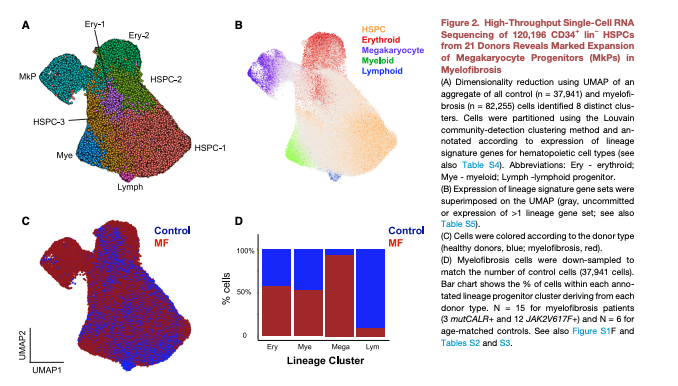

In [661]:
'https://www.cell.com/molecular-cell/pdf/S1097-2765(20)30234-3.pdf'
from pathlib import Path
from IPython.display import Image
from IPython.core.display import HTML    
PATH = "/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_090321_notebooks/YS_Reprocess_250721_updates/mouse_gastrulation_human_YS_combination/Screenshot 2021-11-03 at 12.29.51.png"
Image(filename = PATH , width=500, height=1000)

# Plot genes

In [577]:
markers = {"HSPC":[	"CD34",	"SPINK2",	"HOPX",	"MLLT3",	"HPF",			],
"Ery_lineage":[	"KLF1",	"GYPA",	"ALAS2",	"HEMGN",	"FAM210B",	"HBE1",	"HBZ",	],
"Myeloid_lineage":[	"CD14",	"CD68",	"CD4",	"SPI1",	"TYROBP",			],
"MK_lineage":[	"GP9",	"PF4",	"ITGA2B",	"CLEC1B",	"ITGB3",	"GATA2",		]}

In [578]:
adata_ms_diff.var

,HGNC-0,ENSDB-0,mouse_human_homologs-0,DB Class Key_homogene_db-0,Common Organism Name_homogene_db-0,NCBI Taxon ID_homogene_db-0,Symbol_homogene_db-0,EntrezGene ID_homogene_db-0,Mouse MGI ID_homogene_db-0,HGNC ID_homogene_db-0,...,intersect-1,means-1,dispersions-1,dispersions_norm-1,highly_variable,means,dispersions,dispersions_norm,mean,std
VASN,Vasn,ENSMUSG00000039646,VASN,39505110.0,"mouse, laboratory",10090.0,Vasn,246154.0,MGI:2177651,NaN,...,True,0.218800,1.395735,1.335039,True,0.399394,1.309305,1.292597,0.227922,0.487803
DNASE1L3,Dnase1l3,ENSMUSG00000025279,DNASE1L3,39510523.0,"mouse, laboratory",10090.0,Dnase1l3,13421.0,MGI:1314633,NaN,...,True,0.094719,2.272843,2.904280,True,0.175884,2.276949,4.093647,0.067732,0.317460
HAPLN1,Hapln1,ENSMUSG00000021613,HAPLN1,39504576.0,"mouse, laboratory",10090.0,Hapln1,12950.0,MGI:1337006,NaN,...,True,0.118790,1.757638,1.982523,True,0.271119,1.660348,2.132289,0.131525,0.404747
C1QTNF2,C1qtnf2,ENSMUSG00000046491,C1QTNF2,39506833.0,"mouse, laboratory",10090.0,C1qtnf2,69183.0,MGI:1916433,NaN,...,True,0.060973,0.967211,0.568366,True,0.117782,0.911419,0.753099,0.067457,0.260095
SVEP1,Svep1,ENSMUSG00000028369,SVEP1,39508710.0,"mouse, laboratory",10090.0,Svep1,64817.0,MGI:1928849,NaN,...,True,0.192194,1.349100,1.251606,True,0.355134,1.278282,1.218390,0.198499,0.463083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
IFNGR1,Ifngr1,ENSMUSG00000020009,IFNGR1,39507730.0,"mouse, laboratory",10090.0,Ifngr1,15979.0,MGI:107655,NaN,...,True,0.520188,1.588471,0.931303,True,0.409931,1.380524,1.462953,0.245797,0.473463
MEIS1,Meis1,ENSMUSG00000020160,MEIS1,39502227.0,"mouse, laboratory",10090.0,Meis1,17268.0,MGI:104717,NaN,...,True,0.118549,0.981719,0.594322,True,0.215613,0.896642,0.716952,0.134898,0.337885
RGS16,Rgs16,ENSMUSG00000026475,RGS16,39511303.0,"mouse, laboratory",10090.0,Rgs16,19734.0,MGI:108407,NaN,...,True,0.450337,1.875593,1.547572,True,0.639201,1.848618,1.749778,0.334670,0.637791
HOXC9,Hoxc9,ENSMUSG00000036139,HOXC9,39502241.0,"mouse, laboratory",10090.0,Hoxc9,15427.0,MGI:96199,NaN,...,True,0.060565,0.969355,0.572202,True,0.137768,0.908335,0.745556,0.079390,0.280756


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predicted' as categorical


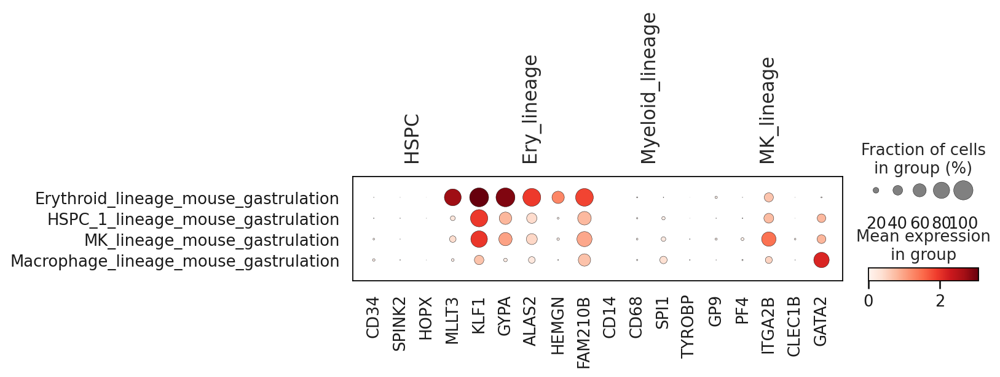

In [579]:
for (key, value) in markers.items():
    markers[key] = [x for x in value if x in list(adata_ms_diff.var.index.values)]
sc.pl.dotplot(adata_ms_diff, markers, groupby = 'predicted')

In [580]:
adata_ms = adata[adata.obs['species'].isin(['Mouse'])]

In [581]:
adata_ms.obs['predicted'] = adata_ms.obs['celltype'].astype(str)
adata_ms.obs.loc[adata_ms.obs.index.isin(pred_out.index),'predicted'] = pred_out['predicted']

Trying to set attribute `.obs` of view, copying.


ValueError: Must have equal len keys and value when setting with an iterable

In [584]:
adata.var

,HGNC-0,ENSDB-0,mouse_human_homologs-0,DB Class Key_homogene_db-0,Common Organism Name_homogene_db-0,NCBI Taxon ID_homogene_db-0,Symbol_homogene_db-0,EntrezGene ID_homogene_db-0,Mouse MGI ID_homogene_db-0,HGNC ID_homogene_db-0,...,intersect-1,means-1,dispersions-1,dispersions_norm-1,highly_variable,means,dispersions,dispersions_norm,mean,std
VASN,Vasn,ENSMUSG00000039646,VASN,39505110.0,"mouse, laboratory",10090.0,Vasn,246154.0,MGI:2177651,NaN,...,True,0.218800,1.395735,1.335039,True,0.399394,1.309305,1.292597,0.227922,0.487803
DNASE1L3,Dnase1l3,ENSMUSG00000025279,DNASE1L3,39510523.0,"mouse, laboratory",10090.0,Dnase1l3,13421.0,MGI:1314633,NaN,...,True,0.094719,2.272843,2.904280,True,0.175884,2.276949,4.093647,0.067732,0.317460
HAPLN1,Hapln1,ENSMUSG00000021613,HAPLN1,39504576.0,"mouse, laboratory",10090.0,Hapln1,12950.0,MGI:1337006,NaN,...,True,0.118790,1.757638,1.982523,True,0.271119,1.660348,2.132289,0.131525,0.404747
C1QTNF2,C1qtnf2,ENSMUSG00000046491,C1QTNF2,39506833.0,"mouse, laboratory",10090.0,C1qtnf2,69183.0,MGI:1916433,NaN,...,True,0.060973,0.967211,0.568366,True,0.117782,0.911419,0.753099,0.067457,0.260095
SVEP1,Svep1,ENSMUSG00000028369,SVEP1,39508710.0,"mouse, laboratory",10090.0,Svep1,64817.0,MGI:1928849,NaN,...,True,0.192194,1.349100,1.251606,True,0.355134,1.278282,1.218390,0.198499,0.463083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
IFNGR1,Ifngr1,ENSMUSG00000020009,IFNGR1,39507730.0,"mouse, laboratory",10090.0,Ifngr1,15979.0,MGI:107655,NaN,...,True,0.520188,1.588471,0.931303,True,0.409931,1.380524,1.462953,0.245797,0.473463
MEIS1,Meis1,ENSMUSG00000020160,MEIS1,39502227.0,"mouse, laboratory",10090.0,Meis1,17268.0,MGI:104717,NaN,...,True,0.118549,0.981719,0.594322,True,0.215613,0.896642,0.716952,0.134898,0.337885
RGS16,Rgs16,ENSMUSG00000026475,RGS16,39511303.0,"mouse, laboratory",10090.0,Rgs16,19734.0,MGI:108407,NaN,...,True,0.450337,1.875593,1.547572,True,0.639201,1.848618,1.749778,0.334670,0.637791
HOXC9,Hoxc9,ENSMUSG00000036139,HOXC9,39502241.0,"mouse, laboratory",10090.0,Hoxc9,15427.0,MGI:96199,NaN,...,True,0.060565,0.969355,0.572202,True,0.137768,0.908335,0.745556,0.079390,0.280756


In [585]:
#fig4 ext
fig = ['MIF','LGALS3','LY6E','PRSS3','CLDN7','GSTA2','PPDPF','TMSB10','SERPINA4','SERPINA5','SERPINF2','SERPING1','ADH1A',  'ADH6','ALDOB','ALDH1A1','APOH','CYP3A7','CYP4A11','CYP27A1','A1BG','ITIH1','ITIH2','GC','ALB','F12','CPB2']
print(len(fig))
print(len(adata_ms_diff.var['mouse_human_homologs-0'][adata_ms_diff.var['mouse_human_homologs-0'].isin(fig)]))
adata_ms_diff.var['mouse_human_homologs-0'][adata_ms_diff.var['mouse_human_homologs-0'].isin(fig)]

27
7


ALB              ALB
ALDOB          ALDOB
SERPING1    SERPING1
CLDN7          CLDN7
LY6E            LY6E
APOH            APOH
LGALS3        LGALS3
Name: mouse_human_homologs-0, dtype: object

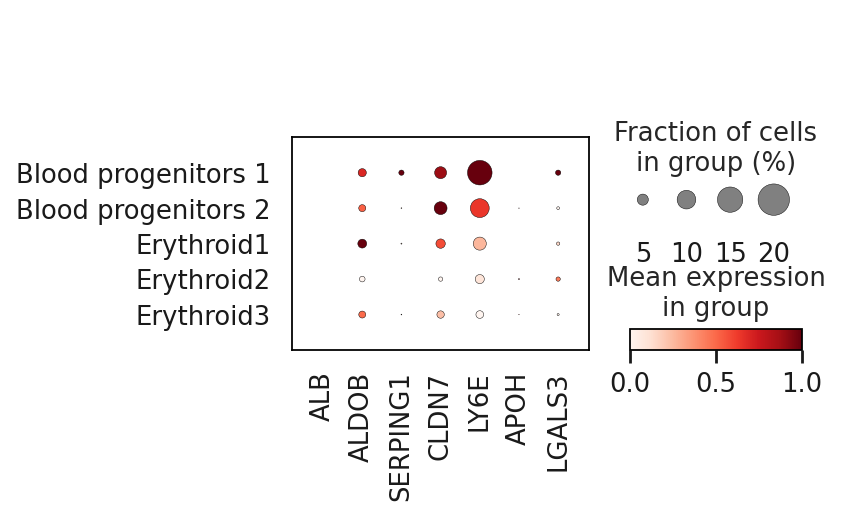

In [587]:
sc.pl.dotplot(adata_ms_diff,groupby = 'celltype',var_names = list(adata_ms_diff.var['mouse_human_homologs-0'][adata_ms_diff.var['mouse_human_homologs-0'].isin(fig)]),standard_scale='var',save = 'mouse_endoderm_dotplot_all_cells')


In [ ]:
sc.pl.dotplot(adata2[adata2.obs['celltype'].isin(['ExE endoderm'])],groupby = 'celltype',var_names = list(adata2.var['mouse_human_homologs'][adata2.var['mouse_human_homologs'].isin(fig)]),standard_scale='var',save = 'mouse_endoderm_dotplot_all_cells')

# Grab raw data to perform diff expression analyses

In [615]:
adata_raw = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/mouse_gastrulation_data/mouse_data_built_261021_raw_enst.h5ad')
adata_raw.var

,HGNC,mouse_human_homologs,DB Class Key_homogene_db,Common Organism Name_homogene_db,NCBI Taxon ID_homogene_db,Symbol_homogene_db,EntrezGene ID_homogene_db,Mouse MGI ID_homogene_db,HGNC ID_homogene_db,OMIM Gene ID_homogene_db,Genetic Location_homogene_db,"Genomic Coordinates (mouse: , human: )_homogene_db",Nucleotide RefSeq IDs_homogene_db,Protein RefSeq IDs_homogene_db,SWISS_PROT IDs_homogene_db,ets
index,,,,,,,,,,,,,,,,
ENSMUSG00000051951,Xkr4,ENSMUSG00000051951,39520667.0,"mouse, laboratory",10090.0,Xkr4,497097.0,MGI:3528744,NaN,NaN,Chr1 1.6 cM,Chr1:3276124-3741721(-),"NM_001011874,XM_011238395,XM_036152287,XM_0064...","XP_011236697,NP_001011874,XP_036008180,XP_0064...",Q5GH67,ENSMUST00000070533.5
ENSMUSG00000089699,Gm1992,ENSMUSG00000089699,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ENSMUST00000161581.2
ENSMUSG00000102343,Gm37381,ENSMUSG00000102343,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ENSMUST00000192427.2
ENSMUSG00000025900,Rp1,ENSMUSG00000025900,39520074.0,"mouse, laboratory",10090.0,Rp1,19888.0,MGI:1341105,NaN,NaN,Chr1 1.65 cM,Chr1:4185896-4479489(-),"NM_001370921,NM_001195662,NM_011283,XM_030252325","NP_035413,XP_030108185,NP_001357850,NP_001182591",P56716,ENSMUST00000027032.6
ENSMUSG00000025902,Sox17,ENSMUSG00000025902,39501994.0,"mouse, laboratory",10090.0,Sox17,20671.0,MGI:107543,NaN,NaN,Chr1 1.65 cM,Chr1:4561154-4567577(-),"NM_001289466,NM_001289465,NM_011441,XM_0302524...","NP_001276394,NP_001276396,XP_030108265,NP_0012...",Q61473,ENSMUST00000192913.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSMUSG00000079808,AC168977.1,ENSMUSG00000079808,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ENSMUST00000115924.3
ENSMUSG00000095041,AC149090.1,ENSMUSG00000095041,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ENSMUST00000178343.2
ENSMUSG00000063897,DHRSX,ENSMUSG00000063897,39505717.0,human,9606.0,DHRSX,207063.0,NaN,HGNC:18399,OMIM:301034,ChrXY p22.33 and Yp11.2,NaN,NM_145177,NP_660160,Q8N5I4,NaN


In [619]:
adata_raw = adata_raw[adata_raw.obs.index.isin(adata_ms_diff.obs.index)]


In [620]:
adata_raw = adata_raw[adata_raw.obs.index.isin(adata_ms.obs.index)]
adata_raw.obs = adata_ms.obs[:]
adata_raw.obs.loc[adata_raw.obs.index.isin(pred_out.index),'predicted'] = pred_out.loc[pred_out.index.isin(adata_raw.obs.index),'predicted']
adata_raw.var = adata_raw.var.set_index([adata_raw.var['HGNC'].astype(str)])

In [621]:
# basic filtering
adata_raw.var_names_make_unique()
sc.pp.filter_cells(adata_raw, min_genes=200)
sc.pp.filter_genes(adata_raw, min_cells=3)

#scale indpendently
#Total-count normalize (library-size correct) the data matrix 𝐗 to 10,000 reads per cell, so that counts become comparable among cells.
sc.pp.normalize_per_cell(adata_raw, counts_per_cell_after=1e4)
sc.pp.log1p(adata_raw)
sc.pp.highly_variable_genes(adata_raw)

filtered out 14479 genes that are detected in less than 3 cells
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [654]:
high_var = list(adata_raw.var["highly_variable"][adata_raw.var["highly_variable"]==True])
adata_raw = adata_raw[:, adata_raw.var["highly_variable"].isin(high_var)]   

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


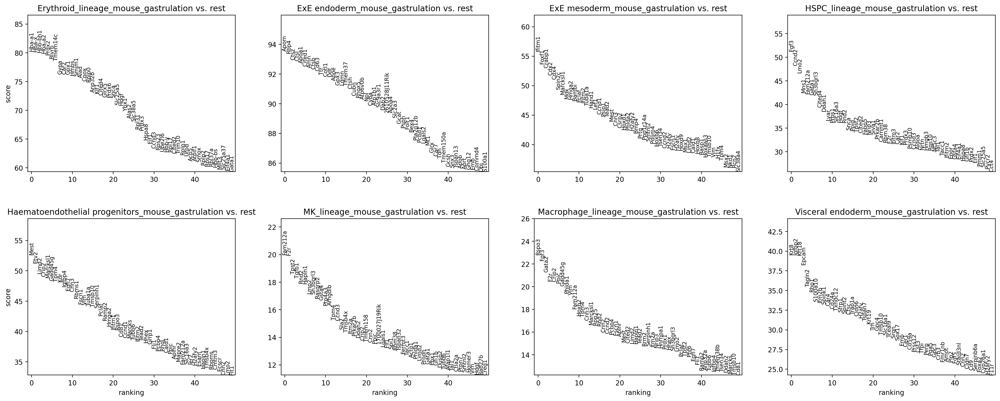

In [655]:
adata_deg = adata_raw
sc.tl.rank_genes_groups(adata_deg, "predicted", method='wilcoxon',n_genes=500)
sc.pl.rank_genes_groups(adata_deg, n_genes=50, sharey=False)

result = adata_deg.uns['rank_genes_groups']
groups = result['names'].dtype.names
    
DE = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges']}).head(500)

DE = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges']}).head(500)
degs = DE
if 'concat' in locals() or 'concat' in globals():
    del(concat)
n = degs.loc[:, degs.columns.str.endswith("_n")]
n = pd.melt(n)
p = degs.loc[:, degs.columns.str.endswith("_p")]
p = pd.melt(p)
l = degs.loc[:, degs.columns.str.endswith("_l")]
l = pd.melt(l)
n = n.replace(regex=r'_n', value='')
n = n.rename(columns={"variable": "cluster", "value": "gene"})
p = (p.drop(["variable"],axis = 1)).rename(columns={ "value": "p_val"})
l = (l.drop(["variable"],axis = 1)).rename(columns={ "value": "logfc"})
concat = pd.concat([n,p,l],axis=1)

# Select only top 10 genes by pvalue of each category to display
top_genes = concat.groupby('cluster').head(2)

In [656]:
concat.to_csv('./mouse_reassigned_DEGS_031121.csv')

In [622]:
concat = pd.read_csv('./mouse_reassigned_DEGS_031121.csv',index_col= 0)

In [623]:
MK_markers = ['PLEK','SOX4','ENO1']

In [624]:
MK_markers = ['Plek','Sox4','Eno1']
concat[concat['gene'].isin(MK_markers)]

,cluster,gene,p_val,logfc
446,Erythroid_lineage_mouse_gastrulation,Plek,6.312058e-01,-1.923392
1055,ExE mesoderm_mouse_gastrulation,Sox4,1.954636e-254,2.437964
1934,HSPC_lineage_mouse_gastrulation,Sox4,5.684034e-01,-0.062849
1961,HSPC_lineage_mouse_gastrulation,Plek,8.088232e-01,0.157052
2062,Haematoendothelial progenitors_mouse_gastrulation,Sox4,2.549564e-189,2.149267
2642,MK_lineage_mouse_gastrulation,Plek,3.113212e-12,7.533558
2841,MK_lineage_mouse_gastrulation,Sox4,8.290468e-03,0.434433
3136,Macrophage_lineage_mouse_gastrulation,Sox4,4.485929e-14,1.237251
3553,Visceral endoderm_mouse_gastrulation,Sox4,6.862515e-123,2.369463


In [625]:
ery_markers = ['Ybx1']
concat[concat['gene'].isin(ery_markers)]

,cluster,gene,p_val,logfc
23,Erythroid_lineage_mouse_gastrulation,Ybx1,0.000000e+00,0.316447
1346,ExE mesoderm_mouse_gastrulation,Ybx1,4.789949e-15,0.075293
1569,HSPC_lineage_mouse_gastrulation,Ybx1,1.270953e-114,0.146483
2252,Haematoendothelial progenitors_mouse_gastrulation,Ybx1,3.694014e-37,0.099426
2690,MK_lineage_mouse_gastrulation,Ybx1,3.602599e-08,0.093016
3085,Macrophage_lineage_mouse_gastrulation,Ybx1,1.162865e-21,0.142871


In [626]:
concat

,cluster,gene,p_val,logfc
0,Erythroid_lineage_mouse_gastrulation,Hba-a1,0.000000e+00,5.840591
1,Erythroid_lineage_mouse_gastrulation,Hba-x,0.000000e+00,5.484164
2,Erythroid_lineage_mouse_gastrulation,Hbb-bh1,0.000000e+00,4.384422
3,Erythroid_lineage_mouse_gastrulation,Hba-a2,0.000000e+00,6.173706
4,Erythroid_lineage_mouse_gastrulation,Prdx2,0.000000e+00,0.902317
...,...,...,...,...
3995,Visceral endoderm_mouse_gastrulation,Grhl3,4.745152e-07,5.952724
3996,Visceral endoderm_mouse_gastrulation,Tspan6,5.311605e-07,0.356443
3997,Visceral endoderm_mouse_gastrulation,Dhx32,5.752195e-07,0.514374
3998,Visceral endoderm_mouse_gastrulation,Tph1,7.762264e-07,6.756365


/home/jovyan/my-conda-envs/workhorse/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'predicted' as categorical


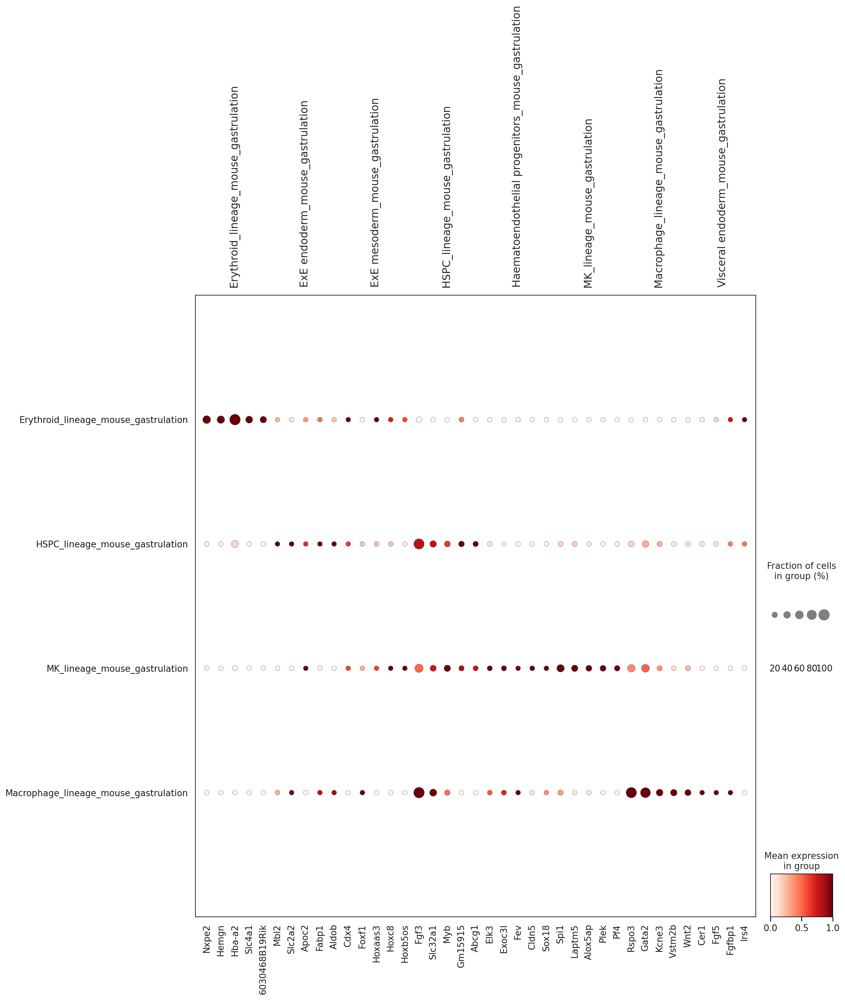

In [627]:
#adata_raw.var_names_make_unique()
#Rank by logfc and then by pval
marker_df = concat.groupby('cluster').apply(lambda grp: grp.nlargest(10, 'logfc')).reset_index(drop=True)
marker_df = marker_df .groupby('cluster').apply(lambda grp: grp.nsmallest(5, 'p_val')).reset_index(drop=True)
markers = marker_df.groupby('cluster')['gene'].apply(list).to_dict()
markers = dict(sorted(markers.items()))
markers = {str(k):v for k,v in markers.items()}

# Get only unique DEGS
from itertools import chain
import numpy as np
df = pd.DataFrame({
    'Cluster' : np.repeat(list(markers.keys()), [len(v) for k, v in markers.items()]),
    'Genes' : list(chain.from_iterable(markers.values())), 
})

#Filter degs by list
for (key, value) in markers.items():
    markers[key] = [x for x in value if x in list(adata_raw.var.index.values)]

data_temp = adata_raw
markers = markers
spot_var = "predicted"
    
import matplotlib
sc.pl.dotplot(data_temp, markers, groupby=spot_var,dendrogram=False,standard_scale='var', smallest_dot=40, color_map='Reds', figsize=(15,15), show = True,save = 'mouse_raw_markers') # title=i